# Benchmarking Field Transformations

### DONE - FT-HMC implemented for 8x8 2D QED (using SiLU as activation function).

- [x] Try to minimize size of the force in training. No significant improvements.
- [x]  Some test on ergodicity
- [x] (calculate the probablity of generating the configs obtained via conventional HMC).

### TODO

- [ ] Plot the force size distribution 
- [ ] Is the large force from the original action or Field-Transformation the determinant?
- [ ] If from the determinant, then the fermion force won't cause problem for HMC
- [ ] Use the same Field-Transformation for larger system (say 16x16, 32x32, 64x64, etc)
- [ ] Study how the delta H depends on the system size ( perhaps delta H ~ sqrt(volume) )
- [ ] Study the auto-correlation for observables, topo, plaq, flowed plaq, etc.
- [ ] Improving the Field-Transformation to reduce force.

## Setup, `import`'s, ..., etc

In [1]:
import os
import sys
import torch

from functools import reduce
from IPython.core.interactiveshell import InteractiveShell

import seaborn as sns
import matplotlib.pyplot as plt

%load_ext autoreload
%autoreload 2

%config InlineBackend.figure_format ='retina'

InteractiveShell.ast_node_interactivity = "all"

plt.style.use('default')
sns.set_style('ticks')
sns.set_palette('bright')
sns.set_context('notebook')
sns.set_palette('bright', color_codes=True)
sns.set_style('ticks')
plt.rc('text', usetex=False)
#plt.rc('xtick.direction', )
#plt.rc('ytick.direction', 'in')

project_dir = os.path.abspath('../../')
if project_dir not in sys.path:
    sys.path.append(project_dir)

Duplicate key in file PosixPath('/home/foremans/.config/matplotlib/stylelib/dark_jupyter.mplstyle'), line 92 ('figure.facecolor: 474747')
Duplicate key in file PosixPath('/home/foremans/.config/matplotlib/stylelib/dark_jupyter.mplstyle'), line 93 ('figure.edgecolor: 0.50')
In /home/foremans/.config/matplotlib/stylelib/dark_jupyter.mplstyle: 
The savefig.jpeg_quality rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.


In [2]:
import fthmc.utils.io as io
logger = io.Logger()

torch.manual_seed(9)
torch.set_default_tensor_type(torch.FloatTensor)

#torch.set_num_threads(param.nth)
#torch.set_num_interop_threads(param.nth_interop)
#os.environ["OMP_NUM_THREADS"] = str(param.nth)
#os.environ["KMP_BLOCKTIME"] = "0"
#os.environ["KMP_SETTINGS"] = "1"
#os.environ["KMP_AFFINITY"]= "granularity=fine,verbose,compact,1,0"

#torch.set_default_tensor_type(torch.DoubleTensor)

## Specify `Param` object

In [3]:
import matplotlib as mpl
# 
from fthmc.utils.param import Param
from fthmc.config import TrainConfig

# (EXACT) action(2) = 0.69777477

from fthmc.train import train
param = {
    'L': 16,
    'tau': 0.5,
    'nrun': 5,
    'beta': 1.0,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 50,
    'seed': 1331,
}

train_config = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 1000,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [16, 16],
    'kernel_size': 5,
    'batch_size': 256,
    'print_freq': 100,
    'plot_freq': 100,
})

param = Param(**param)
logger.log(repr(param))

TORCH DEVICE: cuda


[16:41:48]  Param:                                                                           
            ----------------                                                                 
            beta=1.0                                                                         
            L=16                                                                             
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=50                                                                        
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[16, 16]                                                                     
            nd=2                                                                             
            shape=[2, 16, 16]                                                                
            volume=256                                                                       
            dt=0.05

## Specify directories for saving model, etc

In [4]:
import datetime

from fthmc.train import run as hmc_run
from fthmc.config import LOGS_DIR

DAYSTR = io.get_timestamp('%Y-%m-%d')
NOW = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP = io.get_timestamp('%Y-%m-%d-%H%M%S')

PARAM_DIR = os.path.join(LOGS_DIR, param.uniquestr())
METRICS_DIR = os.path.join(PARAM_DIR, 'metrics')
MODEL_DIR = os.path.join(PARAM_DIR, 'models')
PLOTS_DIR = os.path.join(PARAM_DIR, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR)
io.check_else_make_dir(MODEL_DIR)
io.check_else_make_dir(METRICS_DIR)
io.check_else_make_dir(PLOTS_DIR)

[16:41:50]  Creating directory:                                                              
            /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n256_t0.5_s10

[16:41:50]  Creating directory:                                                              
            /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n256_t0.5_s10/models

[16:41:50]  Creating directory:                                                              
            /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n256_t0.5_s10/metrics

[16:41:50]  Creating directory:                                                              
            /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n256_t0.5_s10/plots

## Specify `TrainConfig` object for training our model

Note, we train the `pre_flow_model` using the Kullback-Leibler divergence:

$$
D_{\mathrm{KL}} = \left(P\|Q\right) = \sum_{x\in\mathcal{X}} P(x)\log\left(\frac{P(x)}{Q(x)}\right)
$$

## Define `TrainConfig` and build model as
```python
model = {
    'prior': MultivariateUniform(...),
    'model': make_u1_equiv_layers(...),
}
```

### Run HMC:

In [5]:
from fthmc.train import run as hmc_run

fields, metrics = hmc_run(param, logger=logger, keep_fields=True)

hmc_metrics_dir = os.path.join(METRICS_DIR, 'hmc')
metrics_file = os.path.join(hmc_metrics_dir, f'hmc_metrics_{NOW}.z')
io.savez(metrics, metrics_file)

[16:42:06]  Param:                                                                           
            ----------------                                                                 
            beta=1.0                                                                         
            L=16                                                                             
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=50                                                                        
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[16, 16]                                                                     
            nd=2                                                                             
            shape=[2, 16, 16]                                                                
            volume=256                                                                       
            dt=0.05

            action=1.000 plaq=0.000 charge=0.000

            dt=0.006 traj=2 accept=True dH=-0.016 expdH=1.016 dq=1.000

            dt=0.006 traj=7 accept=True dH=0.013 expdH=0.987 dq=1.000

            dt=0.006 traj=12 accept=True dH=0.043 expdH=0.958 dq=1.000

            dt=0.006 traj=17 accept=True dH=0.008 expdH=0.992 dq=36.000

            dt=0.006 traj=22 accept=True dH=-0.004 expdH=1.004 dq=9.000

            dt=0.006 traj=27 accept=True dH=-0.017 expdH=1.017 dq=100.000

            dt=0.006 traj=32 accept=True dH=-0.013 expdH=1.013 dq=9.000

            dt=0.006 traj=37 accept=True dH=0.034 expdH=0.966 dq=25.000

            dt=0.006 traj=42 accept=True dH=0.010 expdH=0.990 dq=0.000

            dt=0.006 traj=47 accept=True dH=0.018 expdH=0.982 dq=1.000

            dt=0.006 traj=52 accept=True dH=0.002 expdH=0.998 dq=0.000

            dt=0.006 traj=57 accept=True dH=0.027 expdH=0.973 dq=9.000

            dt=0.006 traj=62 accept=True dH=-0.008 expdH=1.008 dq=4.000

            dt=0.006 traj=67 accept=True dH=-0.008 expdH=1.008 dq=49.000

            dt=0.006 traj=72 accept=True dH=-0.006 expdH=1.006 dq=9.000

[16:42:07]  dt=0.006 traj=77 accept=True dH=-0.002 expdH=1.002 dq=25.000

            dt=0.006 traj=82 accept=True dH=-0.020 expdH=1.020 dq=9.000

            dt=0.006 traj=87 accept=True dH=0.005 expdH=0.995 dq=4.000

            dt=0.006 traj=92 accept=True dH=0.014 expdH=0.986 dq=1.000

            dt=0.006 traj=97 accept=True dH=-0.025 expdH=1.026 dq=0.000

            dt=0.006 traj=102 accept=True dH=-0.003 expdH=1.003 dq=4.000

            dt=0.006 traj=107 accept=True dH=0.022 expdH=0.978 dq=4.000

            dt=0.006 traj=112 accept=True dH=-0.021 expdH=1.021 dq=1.000

            dt=0.006 traj=117 accept=True dH=0.027 expdH=0.973 dq=4.000

            dt=0.006 traj=122 accept=True dH=-0.011 expdH=1.011 dq=1.000

            dt=0.006 traj=127 accept=True dH=0.017 expdH=0.984 dq=9.000

            dt=0.006 traj=132 accept=True dH=-0.023 expdH=1.024 dq=0.000

            dt=0.006 traj=137 accept=True dH=0.008 expdH=0.992 dq=4.000

            dt=0.006 traj=142 accept=True dH=0.006 expdH=0.994 dq=0.000

            dt=0.006 traj=147 accept=True dH=-0.006 expdH=1.006 dq=1.000

            dt=0.006 traj=152 accept=True dH=-0.017 expdH=1.017 dq=9.000

            dt=0.006 traj=157 accept=True dH=0.003 expdH=0.997 dq=1.000

            dt=0.006 traj=162 accept=True dH=-0.002 expdH=1.002 dq=0.000

            dt=0.006 traj=167 accept=True dH=-0.010 expdH=1.010 dq=1.000

            dt=0.006 traj=172 accept=True dH=-0.028 expdH=1.028 dq=1.000

            dt=0.006 traj=177 accept=True dH=-0.002 expdH=1.002 dq=9.000

            dt=0.006 traj=182 accept=True dH=-0.035 expdH=1.036 dq=1.000

            dt=0.006 traj=187 accept=True dH=0.002 expdH=0.998 dq=1.000

            dt=0.006 traj=192 accept=True dH=-0.002 expdH=1.002 dq=0.000

            dt=0.006 traj=197 accept=True dH=0.012 expdH=0.988 dq=9.000

            dt=0.006 traj=202 accept=True dH=-0.001 expdH=1.001 dq=4.000

            dt=0.006 traj=207 accept=True dH=-0.013 expdH=1.013 dq=25.000

            dt=0.006 traj=212 accept=True dH=0.033 expdH=0.968 dq=4.000

[16:42:08]  dt=0.006 traj=217 accept=True dH=0.031 expdH=0.970 dq=9.000

            dt=0.006 traj=222 accept=True dH=-0.017 expdH=1.018 dq=4.000

            dt=0.006 traj=227 accept=True dH=0.004 expdH=0.996 dq=16.000

            dt=0.006 traj=232 accept=True dH=0.036 expdH=0.964 dq=1.000

            dt=0.006 traj=237 accept=True dH=0.005 expdH=0.995 dq=16.000

            dt=0.006 traj=242 accept=True dH=-0.013 expdH=1.013 dq=1.000

            dt=0.006 traj=247 accept=True dH=0.054 expdH=0.947 dq=1.000

            dt=0.006 traj=252 accept=True dH=0.011 expdH=0.989 dq=4.000

            dt=0.006 traj=258 accept=True dH=0.016 expdH=0.984 dq=4.000

            dt=0.006 traj=263 accept=True dH=-0.014 expdH=1.014 dq=4.000

            dt=0.006 traj=268 accept=True dH=-0.020 expdH=1.020 dq=1.000

            dt=0.006 traj=273 accept=True dH=-0.016 expdH=1.016 dq=1.000

            dt=0.006 traj=278 accept=True dH=0.005 expdH=0.995 dq=1.000

            dt=0.006 traj=283 accept=True dH=0.020 expdH=0.980 dq=4.000

            dt=0.006 traj=288 accept=True dH=0.029 expdH=0.971 dq=0.000

            dt=0.006 traj=293 accept=True dH=0.011 expdH=0.989 dq=4.000

            dt=0.006 traj=298 accept=True dH=-0.014 expdH=1.014 dq=9.000

            dt=0.006 traj=303 accept=True dH=0.021 expdH=0.980 dq=9.000

            dt=0.006 traj=308 accept=True dH=0.017 expdH=0.983 dq=0.000

            dt=0.006 traj=313 accept=True dH=0.015 expdH=0.985 dq=9.000

            dt=0.006 traj=318 accept=True dH=0.021 expdH=0.980 dq=25.000

            dt=0.006 traj=323 accept=True dH=0.001 expdH=0.999 dq=9.000

            dt=0.006 traj=328 accept=True dH=-0.029 expdH=1.029 dq=9.000

            dt=0.006 traj=333 accept=True dH=0.007 expdH=0.993 dq=0.000

            dt=0.006 traj=338 accept=True dH=0.004 expdH=0.996 dq=4.000

            dt=0.006 traj=343 accept=True dH=0.029 expdH=0.971 dq=9.000

            dt=0.006 traj=348 accept=True dH=-0.003 expdH=1.003 dq=25.000

[16:42:09]  dt=0.006 traj=353 accept=True dH=0.007 expdH=0.993 dq=1.000

            dt=0.006 traj=358 accept=True dH=-0.015 expdH=1.015 dq=9.000

            dt=0.006 traj=363 accept=True dH=-0.021 expdH=1.021 dq=1.000

            dt=0.006 traj=368 accept=True dH=-0.017 expdH=1.017 dq=0.000

            dt=0.006 traj=373 accept=True dH=-0.033 expdH=1.033 dq=25.000

            dt=0.006 traj=378 accept=True dH=-0.003 expdH=1.003 dq=4.000

            dt=0.006 traj=383 accept=True dH=0.003 expdH=0.997 dq=1.000

            dt=0.006 traj=388 accept=True dH=-0.008 expdH=1.008 dq=9.000

            dt=0.006 traj=393 accept=True dH=0.020 expdH=0.980 dq=4.000

            dt=0.006 traj=398 accept=True dH=0.014 expdH=0.987 dq=1.000

            dt=0.006 traj=403 accept=True dH=-0.020 expdH=1.020 dq=25.000

            dt=0.006 traj=408 accept=True dH=0.019 expdH=0.981 dq=16.000

            dt=0.006 traj=413 accept=True dH=0.021 expdH=0.979 dq=0.000

            dt=0.006 traj=418 accept=True dH=-0.028 expdH=1.028 dq=25.000

            dt=0.006 traj=423 accept=True dH=-0.000 expdH=1.000 dq=64.000

            dt=0.006 traj=428 accept=True dH=0.005 expdH=0.995 dq=1.000

            dt=0.006 traj=433 accept=True dH=-0.023 expdH=1.023 dq=1.000

            dt=0.006 traj=438 accept=True dH=0.009 expdH=0.991 dq=25.000

            dt=0.006 traj=443 accept=True dH=-0.019 expdH=1.019 dq=1.000

            dt=0.006 traj=448 accept=True dH=0.031 expdH=0.969 dq=0.000

            dt=0.006 traj=453 accept=True dH=0.010 expdH=0.990 dq=1.000

            dt=0.006 traj=458 accept=True dH=-0.038 expdH=1.038 dq=16.000

            dt=0.006 traj=463 accept=True dH=-0.013 expdH=1.014 dq=1.000

            dt=0.006 traj=468 accept=True dH=0.013 expdH=0.987 dq=4.000

            dt=0.006 traj=473 accept=True dH=-0.008 expdH=1.008 dq=1.000

            dt=0.006 traj=478 accept=True dH=0.006 expdH=0.994 dq=16.000

            dt=0.006 traj=483 accept=True dH=0.003 expdH=0.997 dq=0.000

            dt=0.006 traj=488 accept=True dH=0.028 expdH=0.972 dq=9.000

            dt=0.006 traj=493 accept=True dH=-0.013 expdH=1.013 dq=1.000

[16:42:10]  dt=0.006 traj=498 accept=True dH=-0.054 expdH=1.055 dq=4.000

            dt=0.006 traj=503 accept=True dH=0.005 expdH=0.995 dq=9.000

            dt=0.006 traj=508 accept=True dH=-0.029 expdH=1.029 dq=9.000

            dt=0.006 traj=514 accept=True dH=0.048 expdH=0.953 dq=9.000

            dt=0.006 traj=519 accept=True dH=-0.005 expdH=1.005 dq=16.000

            dt=0.006 traj=524 accept=True dH=0.015 expdH=0.985 dq=4.000

            dt=0.006 traj=529 accept=True dH=0.013 expdH=0.987 dq=1.000

            dt=0.006 traj=534 accept=True dH=-0.028 expdH=1.028 dq=4.000

            dt=0.006 traj=539 accept=True dH=0.001 expdH=0.999 dq=4.000

            dt=0.006 traj=544 accept=True dH=0.022 expdH=0.979 dq=16.000

            dt=0.006 traj=549 accept=True dH=0.006 expdH=0.994 dq=16.000

            dt=0.006 traj=554 accept=True dH=0.042 expdH=0.959 dq=1.000

            dt=0.006 traj=559 accept=True dH=-0.021 expdH=1.021 dq=16.000

            dt=0.006 traj=564 accept=True dH=-0.015 expdH=1.016 dq=1.000

            dt=0.006 traj=569 accept=True dH=-0.019 expdH=1.019 dq=1.000

            dt=0.006 traj=574 accept=True dH=0.033 expdH=0.968 dq=1.000

            dt=0.006 traj=579 accept=True dH=-0.001 expdH=1.001 dq=1.000

            dt=0.006 traj=584 accept=True dH=-0.015 expdH=1.015 dq=0.000

            dt=0.006 traj=589 accept=True dH=0.039 expdH=0.962 dq=4.000

            dt=0.006 traj=594 accept=True dH=-0.003 expdH=1.004 dq=25.000

            dt=0.006 traj=599 accept=True dH=-0.023 expdH=1.023 dq=1.000

            dt=0.006 traj=604 accept=True dH=0.048 expdH=0.953 dq=1.000

            dt=0.006 traj=609 accept=True dH=-0.011 expdH=1.011 dq=4.000

            dt=0.006 traj=614 accept=True dH=0.002 expdH=0.998 dq=36.000

            dt=0.006 traj=619 accept=True dH=-0.013 expdH=1.013 dq=25.000

            dt=0.006 traj=624 accept=True dH=-0.004 expdH=1.004 dq=4.000

            dt=0.006 traj=629 accept=True dH=0.023 expdH=0.978 dq=9.000

            dt=0.006 traj=634 accept=True dH=0.028 expdH=0.972 dq=9.000

[16:42:11]  dt=0.006 traj=639 accept=True dH=0.003 expdH=0.997 dq=36.000

            dt=0.006 traj=644 accept=True dH=-0.002 expdH=1.002 dq=1.000

            dt=0.006 traj=649 accept=True dH=0.005 expdH=0.995 dq=9.000

            dt=0.006 traj=654 accept=True dH=0.013 expdH=0.987 dq=4.000

            dt=0.006 traj=659 accept=True dH=-0.001 expdH=1.001 dq=0.000

            dt=0.006 traj=664 accept=True dH=0.001 expdH=0.999 dq=9.000

            dt=0.006 traj=669 accept=True dH=-0.026 expdH=1.027 dq=4.000

            dt=0.006 traj=674 accept=True dH=0.003 expdH=0.997 dq=1.000

            dt=0.006 traj=679 accept=True dH=0.043 expdH=0.958 dq=1.000

            dt=0.006 traj=684 accept=True dH=-0.021 expdH=1.021 dq=36.000

            dt=0.006 traj=689 accept=True dH=0.012 expdH=0.988 dq=0.000

            dt=0.006 traj=694 accept=True dH=-0.009 expdH=1.009 dq=25.000

            dt=0.006 traj=699 accept=True dH=-0.004 expdH=1.004 dq=4.000

            dt=0.006 traj=704 accept=True dH=-0.001 expdH=1.001 dq=0.000

            dt=0.006 traj=709 accept=True dH=0.013 expdH=0.987 dq=0.000

            dt=0.006 traj=714 accept=True dH=-0.010 expdH=1.010 dq=16.000

            dt=0.006 traj=719 accept=True dH=0.009 expdH=0.991 dq=4.000

            dt=0.006 traj=724 accept=True dH=-0.023 expdH=1.024 dq=25.000

            dt=0.006 traj=729 accept=True dH=0.010 expdH=0.990 dq=4.000

            dt=0.006 traj=734 accept=True dH=-0.012 expdH=1.012 dq=9.000

            dt=0.006 traj=739 accept=True dH=-0.013 expdH=1.013 dq=49.000

            dt=0.006 traj=744 accept=True dH=-0.020 expdH=1.020 dq=1.000

            dt=0.006 traj=749 accept=True dH=0.037 expdH=0.964 dq=16.000

            dt=0.006 traj=754 accept=True dH=-0.019 expdH=1.019 dq=4.000

            dt=0.006 traj=759 accept=True dH=0.008 expdH=0.992 dq=1.000

            dt=0.006 traj=764 accept=True dH=-0.015 expdH=1.015 dq=1.000

            dt=0.006 traj=770 accept=True dH=0.029 expdH=0.972 dq=16.000

[16:42:12]  dt=0.006 traj=775 accept=True dH=0.023 expdH=0.977 dq=9.000

            dt=0.006 traj=780 accept=True dH=0.017 expdH=0.984 dq=1.000

            dt=0.006 traj=785 accept=True dH=0.003 expdH=0.997 dq=9.000

            dt=0.006 traj=790 accept=True dH=-0.017 expdH=1.017 dq=25.000

            dt=0.006 traj=795 accept=True dH=-0.018 expdH=1.018 dq=4.000

            dt=0.006 traj=800 accept=True dH=-0.007 expdH=1.007 dq=0.000

            dt=0.006 traj=805 accept=True dH=-0.003 expdH=1.003 dq=0.000

            dt=0.006 traj=810 accept=True dH=0.006 expdH=0.994 dq=1.000

            dt=0.006 traj=815 accept=True dH=0.017 expdH=0.983 dq=1.000

            dt=0.006 traj=820 accept=True dH=-0.033 expdH=1.033 dq=25.000

            dt=0.006 traj=825 accept=True dH=0.016 expdH=0.984 dq=1.000

            dt=0.006 traj=830 accept=True dH=0.020 expdH=0.980 dq=1.000

            dt=0.006 traj=835 accept=True dH=-0.033 expdH=1.034 dq=9.000

            dt=0.006 traj=840 accept=True dH=-0.023 expdH=1.023 dq=36.000

            dt=0.006 traj=845 accept=True dH=0.007 expdH=0.993 dq=25.000

            dt=0.006 traj=850 accept=True dH=0.018 expdH=0.982 dq=16.000

            dt=0.006 traj=855 accept=True dH=0.032 expdH=0.969 dq=4.000

            dt=0.006 traj=860 accept=True dH=0.010 expdH=0.990 dq=9.000

            dt=0.006 traj=865 accept=True dH=-0.021 expdH=1.022 dq=1.000

            dt=0.006 traj=870 accept=True dH=0.008 expdH=0.992 dq=0.000

            dt=0.006 traj=875 accept=True dH=-0.007 expdH=1.007 dq=25.000

            dt=0.006 traj=880 accept=True dH=-0.031 expdH=1.032 dq=9.000

            dt=0.006 traj=885 accept=True dH=0.006 expdH=0.994 dq=9.000

            dt=0.006 traj=890 accept=True dH=0.018 expdH=0.982 dq=4.000

            dt=0.006 traj=895 accept=True dH=0.017 expdH=0.983 dq=4.000

            dt=0.006 traj=900 accept=True dH=0.013 expdH=0.987 dq=1.000

            dt=0.006 traj=905 accept=True dH=-0.032 expdH=1.032 dq=1.000

            dt=0.006 traj=910 accept=True dH=0.001 expdH=0.999 dq=1.000

[16:42:13]  dt=0.006 traj=915 accept=True dH=-0.007 expdH=1.007 dq=4.000

            dt=0.006 traj=920 accept=True dH=-0.009 expdH=1.009 dq=36.000

            dt=0.006 traj=925 accept=True dH=0.001 expdH=0.999 dq=0.000

            dt=0.006 traj=930 accept=True dH=-0.014 expdH=1.014 dq=0.000

            dt=0.006 traj=935 accept=True dH=0.025 expdH=0.976 dq=9.000

            dt=0.006 traj=940 accept=True dH=-0.012 expdH=1.012 dq=1.000

            dt=0.006 traj=945 accept=True dH=-0.011 expdH=1.011 dq=1.000

            dt=0.006 traj=950 accept=True dH=0.000 expdH=1.000 dq=16.000

            dt=0.006 traj=955 accept=True dH=-0.011 expdH=1.011 dq=9.000

            dt=0.006 traj=960 accept=True dH=-0.028 expdH=1.029 dq=25.000

            dt=0.006 traj=965 accept=True dH=-0.017 expdH=1.017 dq=4.000

            dt=0.006 traj=970 accept=True dH=-0.015 expdH=1.015 dq=4.000

            dt=0.006 traj=975 accept=True dH=-0.012 expdH=1.012 dq=4.000

            dt=0.006 traj=980 accept=True dH=-0.019 expdH=1.019 dq=16.000

            dt=0.006 traj=985 accept=True dH=0.028 expdH=0.972 dq=4.000

            dt=0.006 traj=990 accept=True dH=-0.026 expdH=1.026 dq=36.000

            dt=0.006 traj=995 accept=True dH=0.000 expdH=1.000 dq=9.000

            dt=0.006 traj=1000 accept=True dH=-0.018 expdH=1.018 dq=16.000

            dt=0.006 traj=1005 accept=True dH=0.014 expdH=0.986 dq=25.000

            dt=0.006 traj=1010 accept=True dH=-0.021 expdH=1.021 dq=4.000

            dt=0.006 traj=1015 accept=True dH=-0.007 expdH=1.007 dq=1.000

            dt=0.007 traj=1020 accept=True dH=0.015 expdH=0.985 dq=4.000

            dt=0.006 traj=1026 accept=True dH=0.016 expdH=0.984 dq=49.000

            dt=0.006 traj=1031 accept=True dH=-0.018 expdH=1.019 dq=9.000

            dt=0.006 traj=1036 accept=True dH=-0.016 expdH=1.016 dq=0.000

            dt=0.006 traj=1041 accept=True dH=-0.034 expdH=1.034 dq=4.000

            dt=0.006 traj=1046 accept=True dH=0.012 expdH=0.988 dq=9.000

            dt=0.006 traj=1051 accept=True dH=0.003 expdH=0.997 dq=4.000

[16:42:14]  dt=0.006 traj=1056 accept=True dH=0.001 expdH=0.999 dq=0.000

            dt=0.006 traj=1061 accept=True dH=0.011 expdH=0.989 dq=9.000

            dt=0.006 traj=1066 accept=True dH=-0.018 expdH=1.018 dq=1.000

            dt=0.006 traj=1071 accept=True dH=-0.014 expdH=1.014 dq=0.000

            dt=0.006 traj=1076 accept=True dH=0.015 expdH=0.985 dq=1.000

            dt=0.006 traj=1081 accept=True dH=0.022 expdH=0.978 dq=0.000

            dt=0.006 traj=1086 accept=True dH=0.006 expdH=0.994 dq=49.000

            dt=0.006 traj=1091 accept=True dH=0.009 expdH=0.991 dq=4.000

            dt=0.006 traj=1096 accept=True dH=0.027 expdH=0.973 dq=1.000

            dt=0.006 traj=1101 accept=True dH=0.016 expdH=0.984 dq=9.000

            dt=0.006 traj=1106 accept=True dH=-0.003 expdH=1.003 dq=16.000

            dt=0.006 traj=1111 accept=True dH=-0.016 expdH=1.016 dq=1.000

            dt=0.006 traj=1116 accept=True dH=-0.007 expdH=1.007 dq=9.000

            dt=0.006 traj=1121 accept=True dH=-0.007 expdH=1.007 dq=16.000

            dt=0.006 traj=1126 accept=True dH=-0.019 expdH=1.019 dq=9.000

            dt=0.006 traj=1131 accept=True dH=-0.035 expdH=1.036 dq=16.000

            dt=0.006 traj=1136 accept=True dH=-0.014 expdH=1.014 dq=1.000

            dt=0.006 traj=1141 accept=True dH=-0.011 expdH=1.011 dq=1.000

            dt=0.006 traj=1146 accept=True dH=-0.039 expdH=1.040 dq=0.000

            dt=0.006 traj=1151 accept=True dH=0.028 expdH=0.972 dq=1.000

            dt=0.006 traj=1156 accept=True dH=-0.009 expdH=1.009 dq=1.000

            dt=0.006 traj=1161 accept=True dH=0.026 expdH=0.974 dq=1.000

            dt=0.006 traj=1166 accept=True dH=0.003 expdH=0.997 dq=9.000

            dt=0.006 traj=1171 accept=True dH=0.001 expdH=0.999 dq=1.000

            dt=0.006 traj=1176 accept=True dH=0.010 expdH=0.990 dq=4.000

            dt=0.006 traj=1181 accept=True dH=0.019 expdH=0.982 dq=4.000

            dt=0.006 traj=1186 accept=True dH=-0.023 expdH=1.023 dq=16.000

[16:42:15]  dt=0.006 traj=1191 accept=True dH=0.012 expdH=0.988 dq=25.000

            dt=0.006 traj=1196 accept=True dH=0.013 expdH=0.987 dq=1.000

            dt=0.006 traj=1201 accept=True dH=0.020 expdH=0.980 dq=1.000

            dt=0.006 traj=1206 accept=True dH=0.046 expdH=0.955 dq=0.000

            dt=0.006 traj=1211 accept=True dH=0.011 expdH=0.989 dq=4.000

            dt=0.006 traj=1216 accept=True dH=0.029 expdH=0.972 dq=25.000

            dt=0.006 traj=1221 accept=True dH=-0.037 expdH=1.038 dq=25.000

            dt=0.006 traj=1226 accept=True dH=0.003 expdH=0.997 dq=0.000

            dt=0.006 traj=1231 accept=True dH=0.026 expdH=0.975 dq=25.000

            dt=0.006 traj=1236 accept=True dH=-0.004 expdH=1.004 dq=0.000

            dt=0.006 traj=1241 accept=True dH=0.009 expdH=0.991 dq=1.000

            dt=0.006 traj=1246 accept=True dH=-0.004 expdH=1.004 dq=1.000

            dt=0.006 traj=1251 accept=True dH=-0.002 expdH=1.002 dq=16.000

            dt=0.006 traj=1256 accept=True dH=-0.031 expdH=1.031 dq=9.000

            dt=0.006 traj=1261 accept=True dH=0.005 expdH=0.995 dq=0.000

            dt=0.006 traj=1266 accept=True dH=0.008 expdH=0.992 dq=4.000

            dt=0.006 traj=1271 accept=True dH=0.014 expdH=0.986 dq=1.000

            dt=0.006 traj=1276 accept=True dH=0.010 expdH=0.990 dq=4.000

            Run times: [0.00585, 1.829825, 0.005772, 1.822141, 0.005826, 1.827335, 0.005891, 
            1.836934, 0.005899, 1.86892]

            Per trajectory: [2.3e-05, 0.007148, 2.3e-05, 0.007118, 2.3e-05, 0.007138,        
            2.3e-05, 0.007176, 2.3e-05, 0.0073]

[16:42:15]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n
            256_t0.5_s10/metrics/hmc

[16:42:15]  Saving <class 'dict'> to /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b
            1.0_n256_t0.5_s10/metrics/hmc/hmc_metrics_2021-05-25-164150.z.

### Train `model_init`:


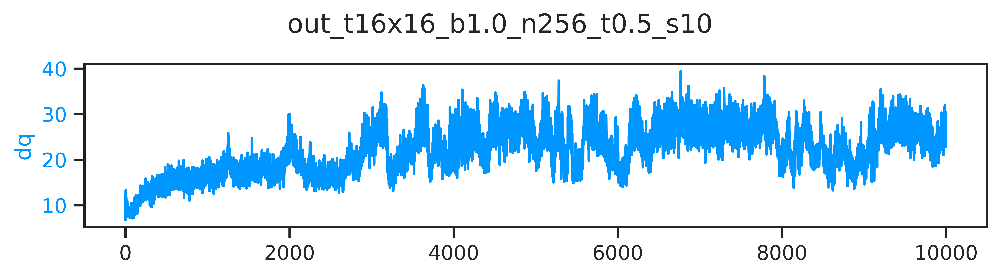

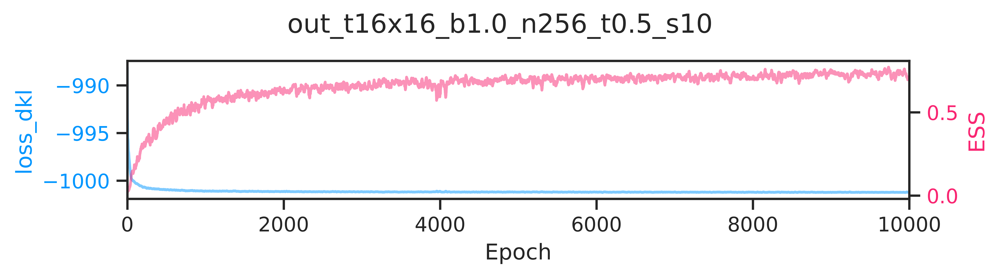

[16:42:28]  ---------------------------------------                                          
            ERA=0, last took: 0 min 0 s                                                      
            ---------------------------------------

[16:42:44]  epoch=97.000 step=0.000 dt=0.133 loss=-1000.13 dq=9.63906 ess=0.17588            
            plaq=0.427082 loss_dkl=-1000.13 logp=109.333 logq=-890.801

[16:42:59]  epoch=197.000 step=0.000 dt=0.133 loss=-1000.58 dq=13.1727 ess=0.277636          
            plaq=0.434403 loss_dkl=-1000.58 logp=111.207 logq=-889.373

[16:43:15]  epoch=297.000 step=0.000 dt=0.133 loss=-1000.75 dq=11.9234 ess=0.311337          
            plaq=0.438521 loss_dkl=-1000.75 logp=112.261 logq=-888.49

[16:43:30]  epoch=397.000 step=0.000 dt=0.133 loss=-1000.89 dq=14.8211 ess=0.406029          
            plaq=0.43938 loss_dkl=-1000.89 logp=112.481 logq=-888.404

[16:43:45]  epoch=497.000 step=0.000 dt=0.133 loss=-1000.93 dq=14.2008 ess=0.43635           
            plaq=0.443217 loss_dkl=-1000.93 logp=113.463 logq=-887.464

[16:44:00]  epoch=597.000 step=0.000 dt=0.133 loss=-1000.98 dq=16.3445 ess=0.47147           
            plaq=0.438043 loss_dkl=-1000.98 logp=112.139 logq=-888.838

[16:44:16]  epoch=697.000 step=0.000 dt=0.133 loss=-1000.99 dq=15.1422 ess=0.471957          
            plaq=0.440873 loss_dkl=-1000.99 logp=112.864 logq=-888.129

[16:44:31]  epoch=797.000 step=0.000 dt=0.134 loss=-1001.06 dq=15.6211 ess=0.546102          
            plaq=0.442564 loss_dkl=-1001.06 logp=113.296 logq=-887.768

[16:44:47]  epoch=897.000 step=0.000 dt=0.134 loss=-1001.05 dq=16.093 ess=0.509256           
            plaq=0.4428 loss_dkl=-1001.05 logp=113.357 logq=-887.692

[16:45:02]  epoch=997.000 step=0.000 dt=0.135 loss=-1001.11 dq=16.6422 ess=0.517804          
            plaq=0.441466 loss_dkl=-1001.11 logp=113.015 logq=-888.097

[16:45:04]  ---------------------------------------                                          
            ERA=1, last took: 2 min 35.87 s                                                  
            ---------------------------------------

[16:45:18]  epoch=97.000 step=97.000 dt=0.133 loss=-1001.07 dq=15.7672 ess=0.485193          
            plaq=0.442786 loss_dkl=-1001.07 logp=113.353 logq=-887.721

[16:45:33]  epoch=197.000 step=197.000 dt=0.133 loss=-1001.1 dq=17.7016 ess=0.581145         
            plaq=0.440706 loss_dkl=-1001.1 logp=112.821 logq=-888.283

[16:45:49]  epoch=297.000 step=297.000 dt=0.134 loss=-1001.1 dq=17.118 ess=0.622892          
            plaq=0.443275 loss_dkl=-1001.1 logp=113.479 logq=-887.622

[16:46:04]  epoch=397.000 step=397.000 dt=0.134 loss=-1001.1 dq=15.8289 ess=0.583187         
            plaq=0.441071 loss_dkl=-1001.1 logp=112.914 logq=-888.183

[16:46:19]  epoch=497.000 step=497.000 dt=0.139 loss=-1001.14 dq=18.6562 ess=0.6112          
            plaq=0.442429 loss_dkl=-1001.14 logp=113.262 logq=-887.875

[16:46:35]  epoch=597.000 step=597.000 dt=0.134 loss=-1001.13 dq=18.4898 ess=0.583775        
            plaq=0.442492 loss_dkl=-1001.13 logp=113.278 logq=-887.856

[16:46:50]  epoch=697.000 step=697.000 dt=0.134 loss=-1001.15 dq=19.1906 ess=0.619428        
            plaq=0.443363 loss_dkl=-1001.15 logp=113.501 logq=-887.646

[16:47:06]  epoch=797.000 step=797.000 dt=0.134 loss=-1001.12 dq=17.9727 ess=0.588894        
            plaq=0.443203 loss_dkl=-1001.12 logp=113.46 logq=-887.656

[16:47:21]  epoch=897.000 step=897.000 dt=0.134 loss=-1001.13 dq=18.2766 ess=0.636182        
            plaq=0.44195 loss_dkl=-1001.13 logp=113.139 logq=-887.987

[16:47:36]  epoch=997.000 step=997.000 dt=0.134 loss=-1001.16 dq=24.1961 ess=0.609728        
            plaq=0.441238 loss_dkl=-1001.16 logp=112.957 logq=-888.206

[16:47:38]  ---------------------------------------                                          
            ERA=2, last took: 2 min 34.03 s                                                  
            ---------------------------------------

[16:47:52]  epoch=97.000 step=194.000 dt=0.134 loss=-1001.15 dq=19.2781 ess=0.640899         
            plaq=0.442841 loss_dkl=-1001.15 logp=113.367 logq=-887.78

[16:48:07]  epoch=197.000 step=394.000 dt=0.135 loss=-1001.12 dq=16.7805 ess=0.664069        
            plaq=0.447265 loss_dkl=-1001.12 logp=114.5 logq=-886.624

[16:48:23]  epoch=297.000 step=594.000 dt=0.138 loss=-1001.15 dq=16.8219 ess=0.640214        
            plaq=0.440685 loss_dkl=-1001.15 logp=112.815 logq=-888.331

[16:48:39]  epoch=397.000 step=794.000 dt=0.137 loss=-1001.18 dq=15.7188 ess=0.660141        
            plaq=0.442053 loss_dkl=-1001.18 logp=113.166 logq=-888.012

[16:48:54]  epoch=497.000 step=994.000 dt=0.137 loss=-1001.17 dq=15.7859 ess=0.607964        
            plaq=0.444998 loss_dkl=-1001.17 logp=113.919 logq=-887.255

[16:49:10]  epoch=597.000 step=1194.000 dt=0.135 loss=-1001.16 dq=17.0141 ess=0.645751       
            plaq=0.442669 loss_dkl=-1001.16 logp=113.323 logq=-887.837

[16:49:26]  epoch=697.000 step=1394.000 dt=0.140 loss=-1001.16 dq=18.2492 ess=0.655692       
            plaq=0.447578 loss_dkl=-1001.16 logp=114.58 logq=-886.583

[16:49:41]  epoch=797.000 step=1594.000 dt=0.138 loss=-1001.2 dq=19.4844 ess=0.650766        
            plaq=0.4418 loss_dkl=-1001.2 logp=113.101 logq=-888.096

[16:49:57]  epoch=897.000 step=1794.000 dt=0.135 loss=-1001.17 dq=22.1672 ess=0.656999       
            plaq=0.443284 loss_dkl=-1001.17 logp=113.481 logq=-887.693

[16:50:13]  epoch=997.000 step=1994.000 dt=0.136 loss=-1001.16 dq=24.4711 ess=0.656588       
            plaq=0.445632 loss_dkl=-1001.16 logp=114.082 logq=-887.077

[16:50:15]  ---------------------------------------                                          
            ERA=3, last took: 2 min 36.43 s                                                  
            ---------------------------------------

[16:50:29]  epoch=97.000 step=291.000 dt=0.137 loss=-1001.18 dq=28.4227 ess=0.696906         
            plaq=0.442379 loss_dkl=-1001.18 logp=113.249 logq=-887.935

[16:50:45]  epoch=197.000 step=591.000 dt=0.136 loss=-1001.16 dq=19.7594 ess=0.685873        
            plaq=0.44617 loss_dkl=-1001.16 logp=114.22 logq=-886.942

[16:51:00]  epoch=297.000 step=891.000 dt=0.135 loss=-1001.2 dq=19.257 ess=0.699862          
            plaq=0.444899 loss_dkl=-1001.2 logp=113.894 logq=-887.308

[16:51:16]  epoch=397.000 step=1191.000 dt=0.136 loss=-1001.16 dq=19.8883 ess=0.667252       
            plaq=0.444687 loss_dkl=-1001.16 logp=113.84 logq=-887.325

[16:51:32]  epoch=497.000 step=1491.000 dt=0.147 loss=-1001.19 dq=20.5445 ess=0.681163       
            plaq=0.444532 loss_dkl=-1001.19 logp=113.8 logq=-887.387

[16:51:49]  epoch=597.000 step=1791.000 dt=0.140 loss=-1001.17 dq=28.8758 ess=0.677058       
            plaq=0.442744 loss_dkl=-1001.17 logp=113.342 logq=-887.829

[16:52:05]  epoch=697.000 step=2091.000 dt=0.138 loss=-1001.21 dq=21.4703 ess=0.689853       
            plaq=0.442709 loss_dkl=-1001.21 logp=113.334 logq=-887.874

[16:52:21]  epoch=797.000 step=2391.000 dt=0.147 loss=-1001.21 dq=24.2805 ess=0.661972       
            plaq=0.446569 loss_dkl=-1001.21 logp=114.322 logq=-886.893

[16:52:38]  epoch=897.000 step=2691.000 dt=0.144 loss=-1001.21 dq=21.9375 ess=0.674986       
            plaq=0.441362 loss_dkl=-1001.21 logp=112.989 logq=-888.223

[16:52:54]  epoch=997.000 step=2991.000 dt=0.136 loss=-1001.16 dq=21.6422 ess=0.648254       
            plaq=0.442604 loss_dkl=-1001.16 logp=113.307 logq=-887.854

[16:52:56]  ---------------------------------------                                          
            ERA=4, last took: 2 min 41.59 s                                                  
            ---------------------------------------

[16:53:10]  epoch=97.000 step=388.000 dt=0.136 loss=-1001.22 dq=21.6328 ess=0.678029         
            plaq=0.446651 loss_dkl=-1001.22 logp=114.343 logq=-886.873

[16:53:26]  epoch=197.000 step=788.000 dt=0.139 loss=-1001.19 dq=24.1531 ess=0.717048        
            plaq=0.44392 loss_dkl=-1001.19 logp=113.644 logq=-887.547

[16:53:42]  epoch=297.000 step=1188.000 dt=0.140 loss=-1001.2 dq=26.6391 ess=0.711925        
            plaq=0.443695 loss_dkl=-1001.2 logp=113.586 logq=-887.617

[16:53:58]  epoch=397.000 step=1588.000 dt=0.138 loss=-1001.23 dq=20.7633 ess=0.68566        
            plaq=0.442824 loss_dkl=-1001.23 logp=113.363 logq=-887.863

[16:54:14]  epoch=497.000 step=1988.000 dt=0.139 loss=-1001.22 dq=29.0227 ess=0.685925       
            plaq=0.440361 loss_dkl=-1001.22 logp=112.732 logq=-888.485

[16:54:30]  epoch=597.000 step=2388.000 dt=0.139 loss=-1001.18 dq=27.6359 ess=0.668305       
            plaq=0.441962 loss_dkl=-1001.18 logp=113.142 logq=-888.034

[16:54:46]  epoch=697.000 step=2788.000 dt=0.141 loss=-1001.19 dq=28.525 ess=0.674268        
            plaq=0.442941 loss_dkl=-1001.19 logp=113.393 logq=-887.8

[16:55:02]  epoch=797.000 step=3188.000 dt=0.138 loss=-1001.19 dq=26.1172 ess=0.699907       
            plaq=0.440917 loss_dkl=-1001.19 logp=112.875 logq=-888.316

[16:55:18]  epoch=897.000 step=3588.000 dt=0.138 loss=-1001.17 dq=28.7797 ess=0.665964       
            plaq=0.446564 loss_dkl=-1001.17 logp=114.32 logq=-886.854

[16:55:34]  epoch=997.000 step=3988.000 dt=0.138 loss=-1001.21 dq=22.7102 ess=0.707898       
            plaq=0.441023 loss_dkl=-1001.21 logp=112.902 logq=-888.31

[16:55:35]  ---------------------------------------                                          
            ERA=5, last took: 2 min 39.25 s                                                  
            ---------------------------------------

[16:55:49]  epoch=97.000 step=485.000 dt=0.138 loss=-1001.21 dq=28.6195 ess=0.71477          
            plaq=0.442778 loss_dkl=-1001.21 logp=113.351 logq=-887.861

[16:56:05]  epoch=197.000 step=985.000 dt=0.138 loss=-1001.16 dq=20.332 ess=0.665819         
            plaq=0.445799 loss_dkl=-1001.16 logp=114.125 logq=-887.036

[16:56:21]  epoch=297.000 step=1485.000 dt=0.138 loss=-1001.22 dq=25.3797 ess=0.689058       
            plaq=0.447458 loss_dkl=-1001.22 logp=114.549 logq=-886.666

[16:56:37]  epoch=397.000 step=1985.000 dt=0.138 loss=-1001.21 dq=26.1961 ess=0.710006       
            plaq=0.443853 loss_dkl=-1001.21 logp=113.626 logq=-887.583

[16:56:53]  epoch=497.000 step=2485.000 dt=0.140 loss=-1001.18 dq=17.9031 ess=0.705565       
            plaq=0.441145 loss_dkl=-1001.18 logp=112.933 logq=-888.247

[16:57:09]  epoch=597.000 step=2985.000 dt=0.138 loss=-1001.2 dq=27.5086 ess=0.694213        
            plaq=0.443624 loss_dkl=-1001.2 logp=113.568 logq=-887.634

[16:57:25]  epoch=697.000 step=3485.000 dt=0.138 loss=-1001.22 dq=25.2227 ess=0.686783       
            plaq=0.443377 loss_dkl=-1001.22 logp=113.505 logq=-887.719

[16:57:41]  epoch=797.000 step=3985.000 dt=0.138 loss=-1001.21 dq=26.7281 ess=0.751432       
            plaq=0.445808 loss_dkl=-1001.21 logp=114.127 logq=-887.088

[16:57:57]  epoch=897.000 step=4485.000 dt=0.138 loss=-1001.23 dq=19.3898 ess=0.71213        
            plaq=0.443922 loss_dkl=-1001.23 logp=113.644 logq=-887.583

[16:58:13]  epoch=997.000 step=4985.000 dt=0.138 loss=-1001.21 dq=19.0492 ess=0.725868       
            plaq=0.441563 loss_dkl=-1001.21 logp=113.04 logq=-888.17

[16:58:14]  ---------------------------------------                                          
            ERA=6, last took: 2 min 39.1 s                                                   
            ---------------------------------------

[16:58:29]  epoch=97.000 step=582.000 dt=0.138 loss=-1001.19 dq=19.6625 ess=0.707983         
            plaq=0.445975 loss_dkl=-1001.19 logp=114.17 logq=-887.022

[16:58:45]  epoch=197.000 step=1182.000 dt=0.138 loss=-1001.23 dq=27.5344 ess=0.694014       
            plaq=0.442852 loss_dkl=-1001.23 logp=113.37 logq=-887.861

[16:59:01]  epoch=297.000 step=1782.000 dt=0.138 loss=-1001.19 dq=26.6063 ess=0.703122       
            plaq=0.442608 loss_dkl=-1001.19 logp=113.308 logq=-887.882

[16:59:17]  epoch=397.000 step=2382.000 dt=0.138 loss=-1001.23 dq=20.4133 ess=0.721915       
            plaq=0.442676 loss_dkl=-1001.23 logp=113.325 logq=-887.907

[16:59:33]  epoch=497.000 step=2982.000 dt=0.138 loss=-1001.17 dq=27.2883 ess=0.68167        
            plaq=0.443538 loss_dkl=-1001.17 logp=113.546 logq=-887.628

[16:59:49]  epoch=597.000 step=3582.000 dt=0.138 loss=-1001.21 dq=30.5898 ess=0.751974       
            plaq=0.44245 loss_dkl=-1001.21 logp=113.267 logq=-887.947

[17:00:04]  epoch=697.000 step=4182.000 dt=0.138 loss=-1001.2 dq=26.3203 ess=0.691362        
            plaq=0.445662 loss_dkl=-1001.2 logp=114.089 logq=-887.111

[17:00:20]  epoch=797.000 step=4782.000 dt=0.138 loss=-1001.22 dq=28.8383 ess=0.696326       
            plaq=0.445854 loss_dkl=-1001.22 logp=114.139 logq=-887.082

[17:00:37]  epoch=897.000 step=5382.000 dt=0.138 loss=-1001.19 dq=27.4859 ess=0.679967       
            plaq=0.442988 loss_dkl=-1001.19 logp=113.405 logq=-887.784

[17:00:53]  epoch=997.000 step=5982.000 dt=0.139 loss=-1001.22 dq=25.3641 ess=0.702567       
            plaq=0.44173 loss_dkl=-1001.22 logp=113.083 logq=-888.14

[17:00:54]  ---------------------------------------                                          
            ERA=7, last took: 2 min 39.97 s                                                  
            ---------------------------------------

[17:01:09]  epoch=97.000 step=679.000 dt=0.138 loss=-1001.22 dq=26.8727 ess=0.678452         
            plaq=0.446063 loss_dkl=-1001.22 logp=114.192 logq=-887.025

[17:01:25]  epoch=197.000 step=1379.000 dt=0.138 loss=-1001.24 dq=29.6562 ess=0.747855       
            plaq=0.442638 loss_dkl=-1001.24 logp=113.315 logq=-887.924

[17:01:41]  epoch=297.000 step=2079.000 dt=0.139 loss=-1001.18 dq=32.2352 ess=0.662785       
            plaq=0.445293 loss_dkl=-1001.18 logp=113.995 logq=-887.184

[17:01:57]  epoch=397.000 step=2779.000 dt=0.138 loss=-1001.19 dq=29.2133 ess=0.704737       
            plaq=0.439014 loss_dkl=-1001.19 logp=112.387 logq=-888.806

[17:02:13]  epoch=497.000 step=3479.000 dt=0.139 loss=-1001.23 dq=26.0242 ess=0.708267       
            plaq=0.445439 loss_dkl=-1001.23 logp=114.032 logq=-887.199

[17:02:29]  epoch=597.000 step=4179.000 dt=0.139 loss=-1001.22 dq=23.7938 ess=0.726169       
            plaq=0.441353 loss_dkl=-1001.22 logp=112.986 logq=-888.237

[17:02:45]  epoch=697.000 step=4879.000 dt=0.139 loss=-1001.21 dq=26.8188 ess=0.688416       
            plaq=0.446984 loss_dkl=-1001.21 logp=114.428 logq=-886.778

[17:03:01]  epoch=797.000 step=5579.000 dt=0.139 loss=-1001.21 dq=26.7594 ess=0.723769       
            plaq=0.443421 loss_dkl=-1001.21 logp=113.516 logq=-887.695

[17:03:17]  epoch=897.000 step=6279.000 dt=0.139 loss=-1001.24 dq=27.7672 ess=0.72965        
            plaq=0.443288 loss_dkl=-1001.24 logp=113.482 logq=-887.757

[17:03:33]  epoch=997.000 step=6979.000 dt=0.139 loss=-1001.22 dq=18.4719 ess=0.716397       
            plaq=0.444347 loss_dkl=-1001.22 logp=113.753 logq=-887.469

[17:03:35]  ---------------------------------------                                          
            ERA=8, last took: 2 min 40.74 s                                                  
            ---------------------------------------

[17:03:49]  epoch=97.000 step=776.000 dt=0.139 loss=-1001.22 dq=23.1789 ess=0.723225         
            plaq=0.443624 loss_dkl=-1001.22 logp=113.568 logq=-887.651

[17:04:06]  epoch=197.000 step=1576.000 dt=0.139 loss=-1001.21 dq=24.2242 ess=0.724174       
            plaq=0.445243 loss_dkl=-1001.21 logp=113.982 logq=-887.227

[17:04:22]  epoch=297.000 step=2376.000 dt=0.139 loss=-1001.2 dq=24.9344 ess=0.677885        
            plaq=0.443532 loss_dkl=-1001.2 logp=113.544 logq=-887.659

[17:04:38]  epoch=397.000 step=3176.000 dt=0.139 loss=-1001.22 dq=19.6406 ess=0.68586        
            plaq=0.444964 loss_dkl=-1001.22 logp=113.911 logq=-887.309

[17:04:54]  epoch=497.000 step=3976.000 dt=0.139 loss=-1001.23 dq=23.525 ess=0.736036        
            plaq=0.442557 loss_dkl=-1001.23 logp=113.295 logq=-887.938

[17:05:10]  epoch=597.000 step=4776.000 dt=0.139 loss=-1001.22 dq=20.4484 ess=0.713604       
            plaq=0.445753 loss_dkl=-1001.22 logp=114.113 logq=-887.108

[17:05:26]  epoch=697.000 step=5576.000 dt=0.139 loss=-1001.26 dq=22.0555 ess=0.726058       
            plaq=0.444454 loss_dkl=-1001.26 logp=113.78 logq=-887.477

[17:05:42]  epoch=797.000 step=6376.000 dt=0.140 loss=-1001.23 dq=16.5609 ess=0.728332       
            plaq=0.442851 loss_dkl=-1001.23 logp=113.37 logq=-887.857

[17:05:58]  epoch=897.000 step=7176.000 dt=0.139 loss=-1001.23 dq=17.6172 ess=0.731641       
            plaq=0.445336 loss_dkl=-1001.23 logp=114.006 logq=-887.22

[17:06:14]  epoch=997.000 step=7976.000 dt=0.139 loss=-1001.23 dq=18.5695 ess=0.74627        
            plaq=0.442896 loss_dkl=-1001.23 logp=113.381 logq=-887.85

[17:06:16]  ---------------------------------------                                          
            ERA=9, last took: 2 min 40.92 s                                                  
            ---------------------------------------

[17:06:30]  epoch=97.000 step=873.000 dt=0.139 loss=-1001.19 dq=26.3414 ess=0.740146         
            plaq=0.442185 loss_dkl=-1001.19 logp=113.199 logq=-887.993

[17:06:46]  epoch=197.000 step=1773.000 dt=0.139 loss=-1001.21 dq=27.7984 ess=0.744562       
            plaq=0.444602 loss_dkl=-1001.21 logp=113.818 logq=-887.396

[17:07:03]  epoch=297.000 step=2673.000 dt=0.139 loss=-1001.25 dq=25.5297 ess=0.753478       
            plaq=0.443665 loss_dkl=-1001.25 logp=113.578 logq=-887.675

[17:07:19]  epoch=397.000 step=3573.000 dt=0.139 loss=-1001.23 dq=28.2914 ess=0.741335       
            plaq=0.44391 loss_dkl=-1001.23 logp=113.641 logq=-887.589

[17:07:35]  epoch=497.000 step=4473.000 dt=0.139 loss=-1001.22 dq=28.2391 ess=0.722364       
            plaq=0.444126 loss_dkl=-1001.22 logp=113.696 logq=-887.52

[17:07:51]  epoch=597.000 step=5373.000 dt=0.139 loss=-1001.21 dq=27.7898 ess=0.709099       
            plaq=0.442247 loss_dkl=-1001.21 logp=113.215 logq=-887.996

[17:08:07]  epoch=697.000 step=6273.000 dt=0.139 loss=-1001.22 dq=26.0414 ess=0.758314       
            plaq=0.445605 loss_dkl=-1001.22 logp=114.075 logq=-887.144

[17:08:23]  epoch=797.000 step=7173.000 dt=0.139 loss=-1001.19 dq=26.7563 ess=0.699711       
            plaq=0.443063 loss_dkl=-1001.19 logp=113.424 logq=-887.769

[17:08:40]  epoch=897.000 step=8073.000 dt=0.139 loss=-1001.21 dq=25.0008 ess=0.722501       
            plaq=0.445166 loss_dkl=-1001.21 logp=113.962 logq=-887.243

[17:08:56]  epoch=997.000 step=8973.000 dt=0.139 loss=-1001.21 dq=26.2016 ess=0.749671       
            plaq=0.441855 loss_dkl=-1001.21 logp=113.115 logq=-888.096

[17:08:58]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n
            256_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150

[17:08:58]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150/dq_training.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150/loss_dkl_ess_training.
            pdf

[17:08:58]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n
            256_t0.5_s10/models/pre_flow_model/2021-05-25-164150

[17:08:58]  Saving checkpoint to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0
            _n256_t0.5_s10/models/pre_flow_model/2021-05-25-164150/pre_flow_model.tar

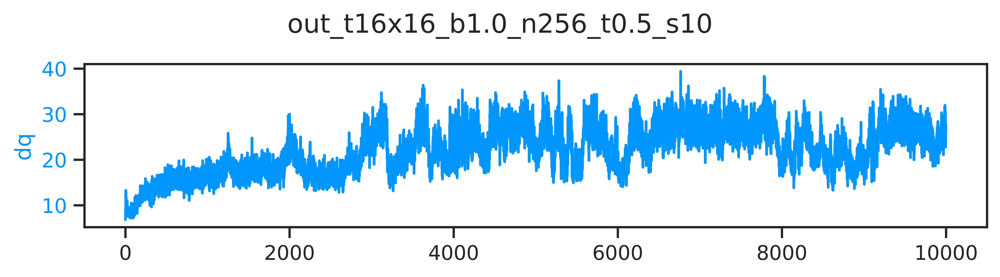

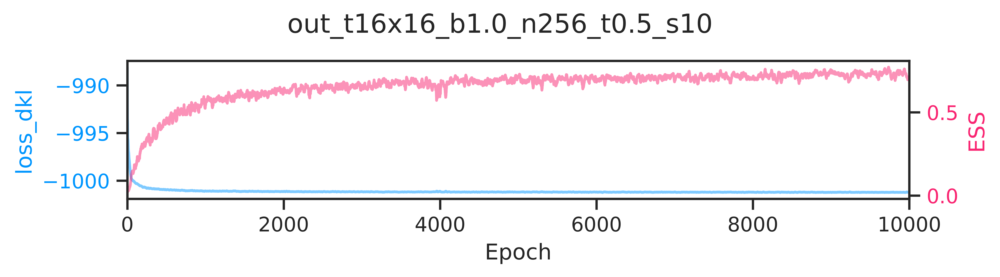

In [6]:
from fthmc.utils.plot_helpers import save_live_plots

mpl.rcParams['text.usetex'] = False

train_outputs = train(param,
                      train_config,
                      pre_model=None,
                      logger=logger,
                      figsize=(7.5, 2))

pre_flow_plots = train_outputs['plots']
pre_flow_history = train_outputs['history']
flow_act = train_outputs['action']

pre_flow_model = train_outputs['model']
pre_flow_optimizer = train_outputs['optimizer_kdl']

plots = train_outputs['plots']
outdir = os.path.join(PLOTS_DIR, 'training', 'pre_flow_model', TSTAMP)

save_live_plots(plots, outdir)

step = train_config.n_era * train_config.n_epoch
outfile = os.path.join(MODEL_DIR, 'pre_flow_model', TSTAMP, 'pre_flow_model.tar')

io.save_checkpoint(
    epoch=step,
    outfile=outfile,
    model=train_outputs['model']['layers'],
    optimizer=train_outputs['optimizer_kdl'],
    history=train_outputs['history'],
)

[17:11:23]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150/step.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150/dt.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150/loss.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150/q.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150/dq.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150/ess.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150/plaq.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150/loss_dkl.pdf

[17:11:24]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150/logp.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-164150/logq.pdf

[17:11:24]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n
            256_t0.5_s10/metrics/training/pre_flow_model/2021-05-25-164150

[17:11:24]  Saving train_metrics to /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1
            .0_n256_t0.5_s10/metrics/training/pre_flow_model/2021-05-25-164150/train_metrics.
            z.

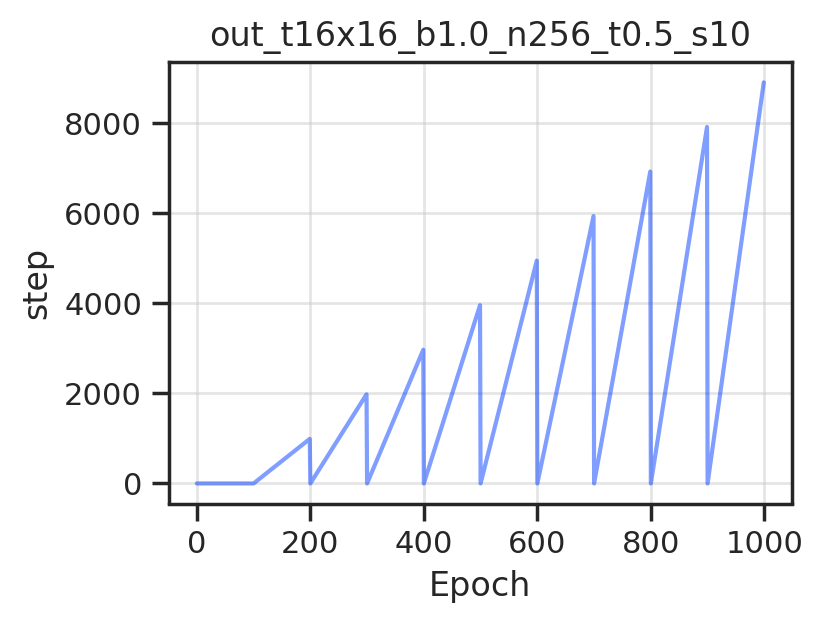

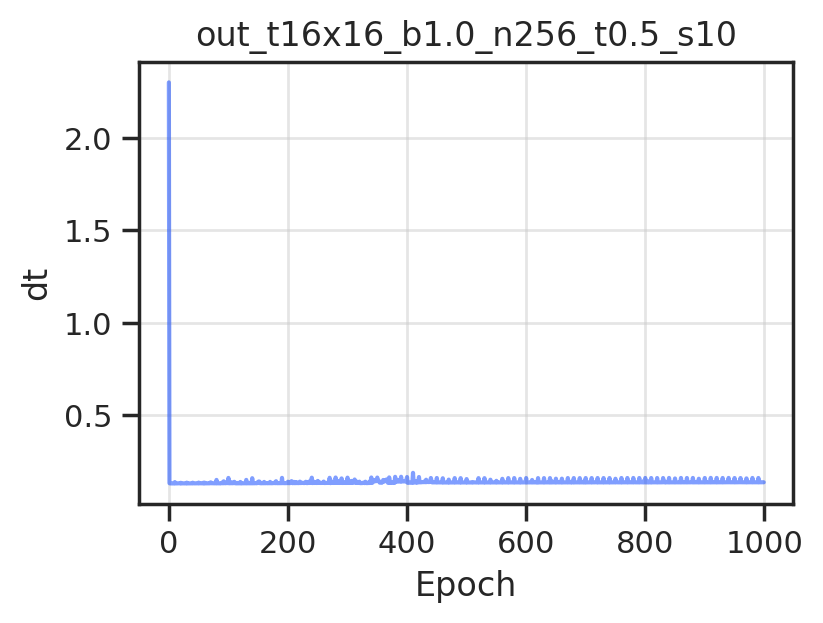

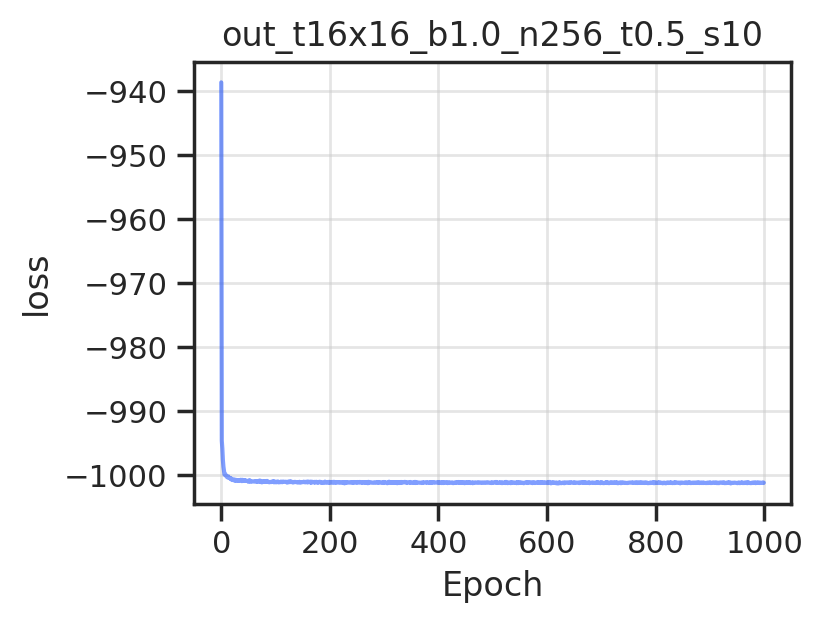

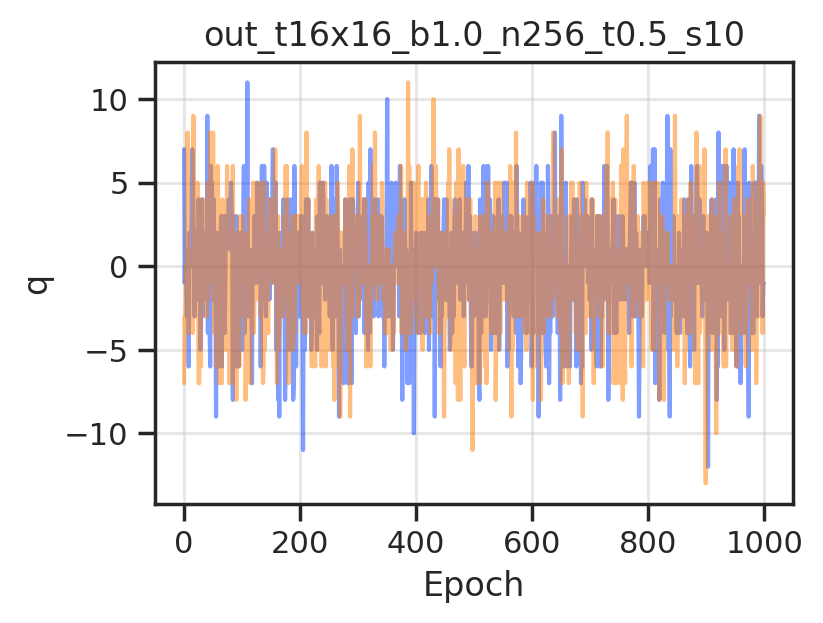

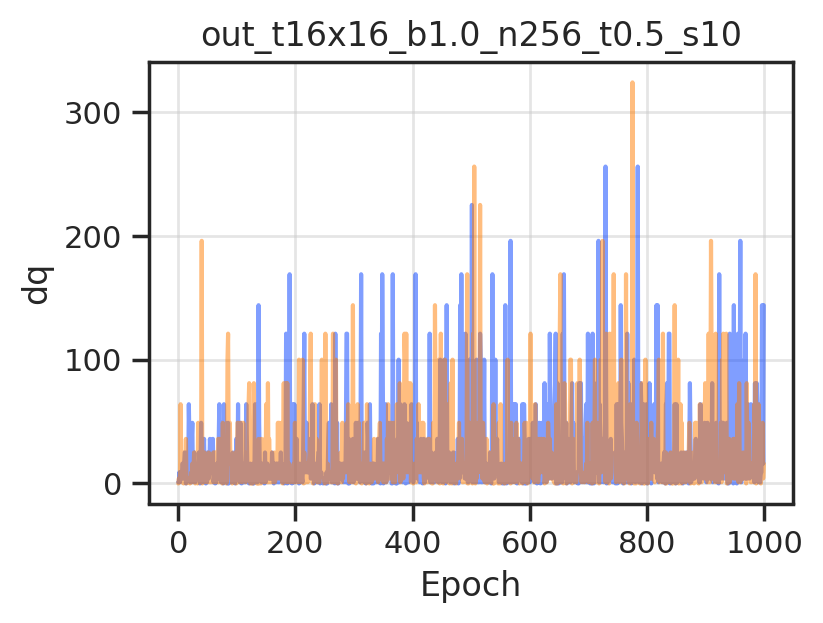

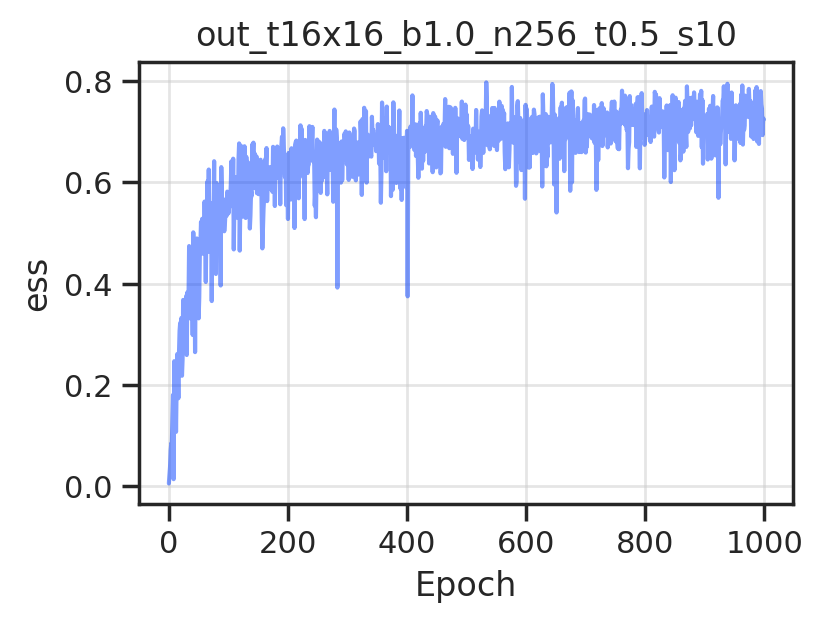

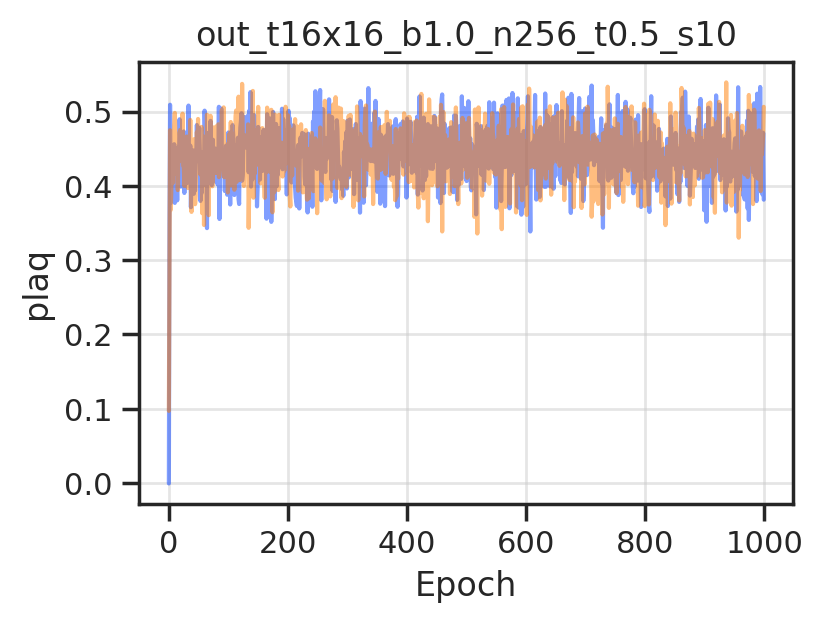

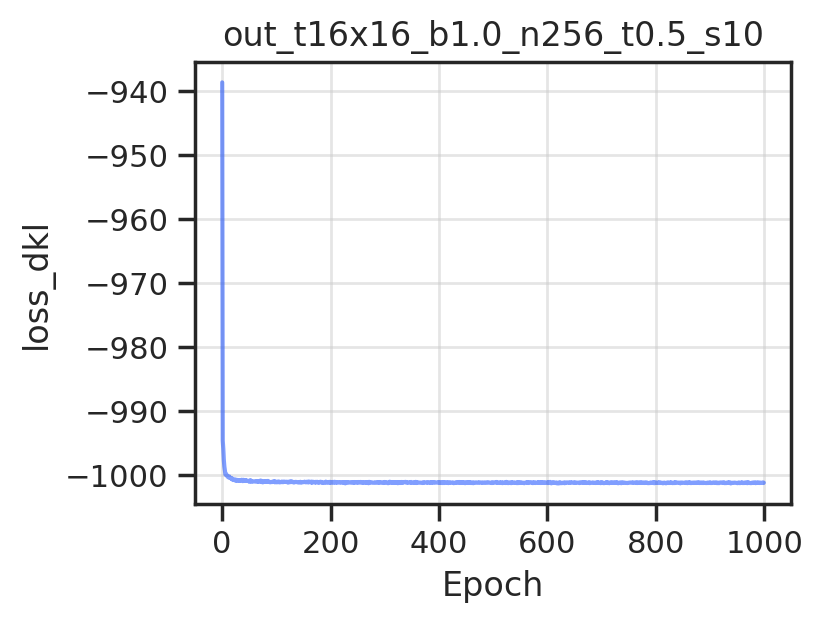

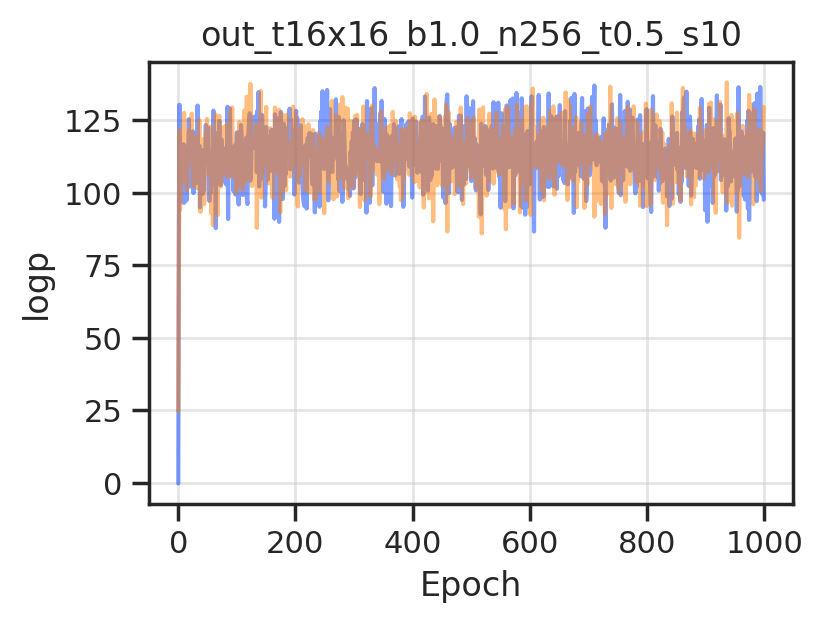

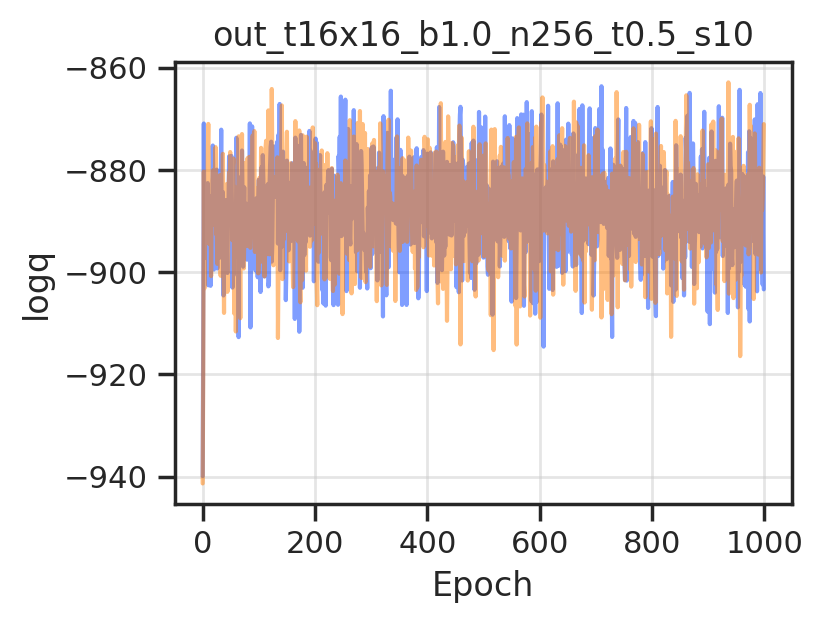

In [7]:
from fthmc.utils.plot_helpers import plot_history

outdir = os.path.join(PLOTS_DIR, 'training', 'pre_flow_model', TSTAMP)
io.check_else_make_dir(outdir)

plot_history(history=train_outputs['history'],
             param=param, skip=['epoch', 'x'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=outdir, alpha=0.5)

outdir = os.path.join(METRICS_DIR, 'training', 'pre_flow_model', TSTAMP)
outfile = os.path.join(outdir, 'train_metrics.z')
io.save_history(train_outputs['history'], outfile, name='train_metrics')

## Run inference on trained model:

[17:11:37]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n
            256_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-164150

[17:11:37]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-164150/ess.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-164150/q.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-164150/dqsq.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-164150/dkl.pdf

[17:11:38]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-164150/logq.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-164150/logp.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-164150/accepted.pdf

[17:11:38]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b1.0_n
            256_t0.5_s10/metrics/inference/pre_flow_model/2021-05-25-164150

[17:11:38]  Saving inference_metrics to /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x1
            6_b1.0_n256_t0.5_s10/metrics/inference/pre_flow_model/2021-05-25-164150/inference
            _metrics.z.

[17:11:38]  Accept rate: 0.643

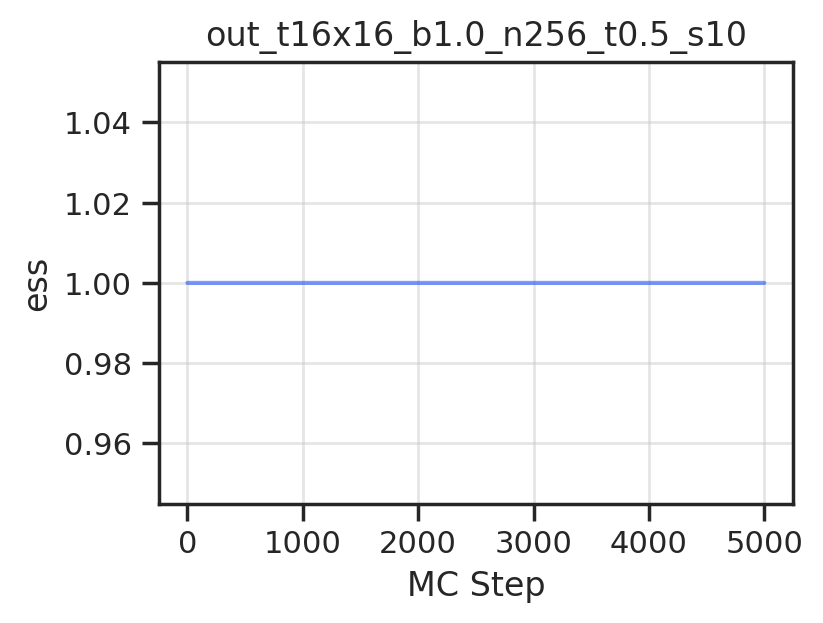

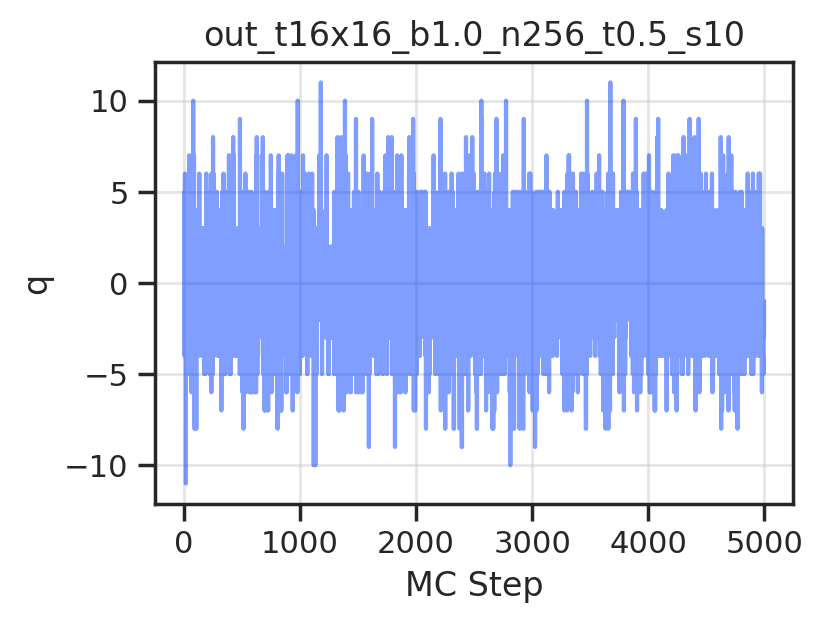

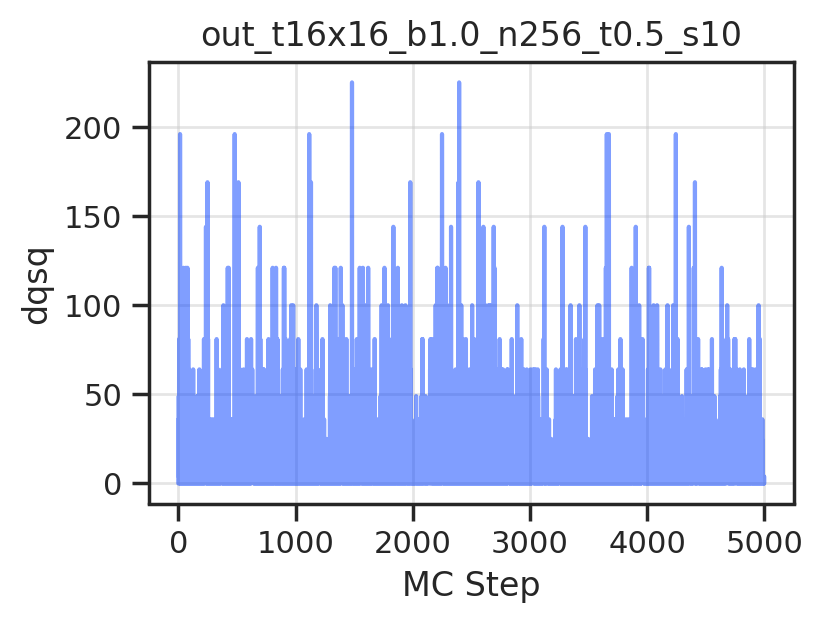

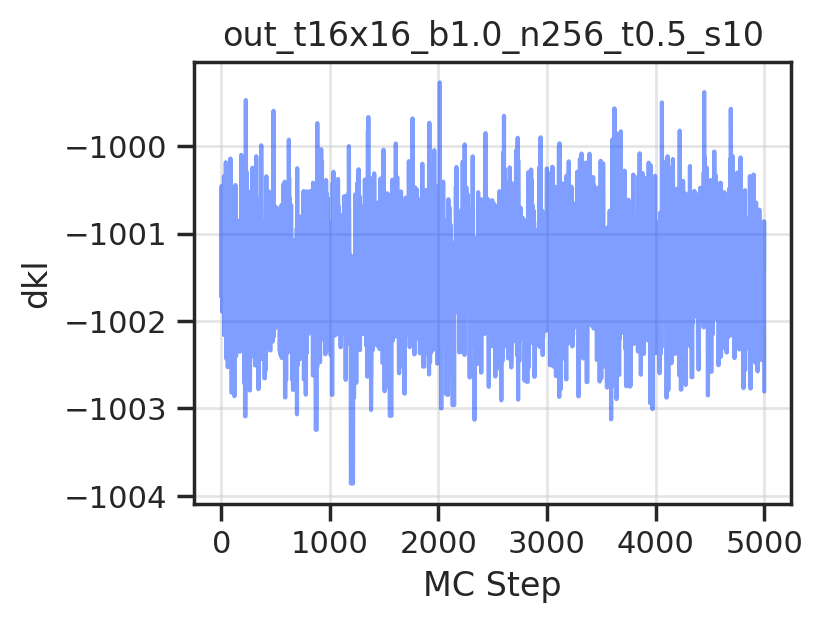

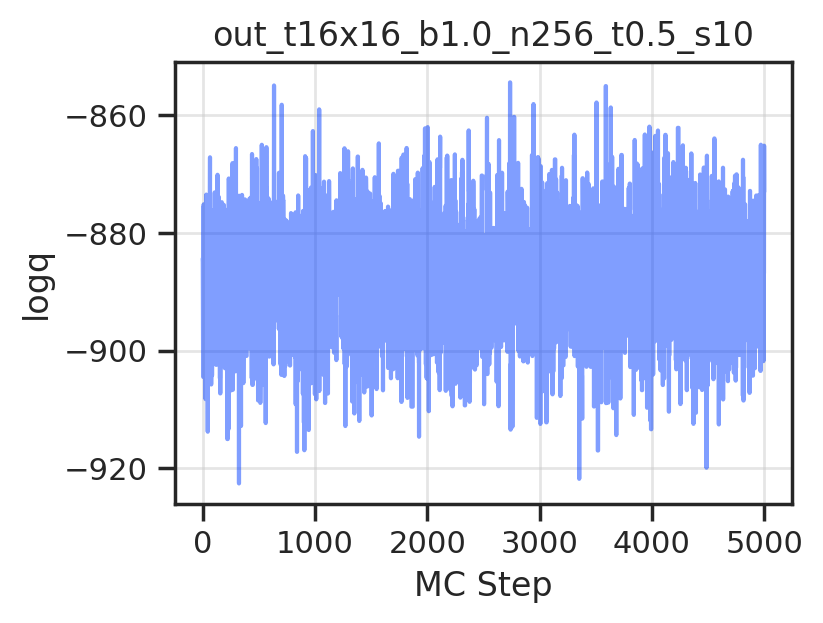

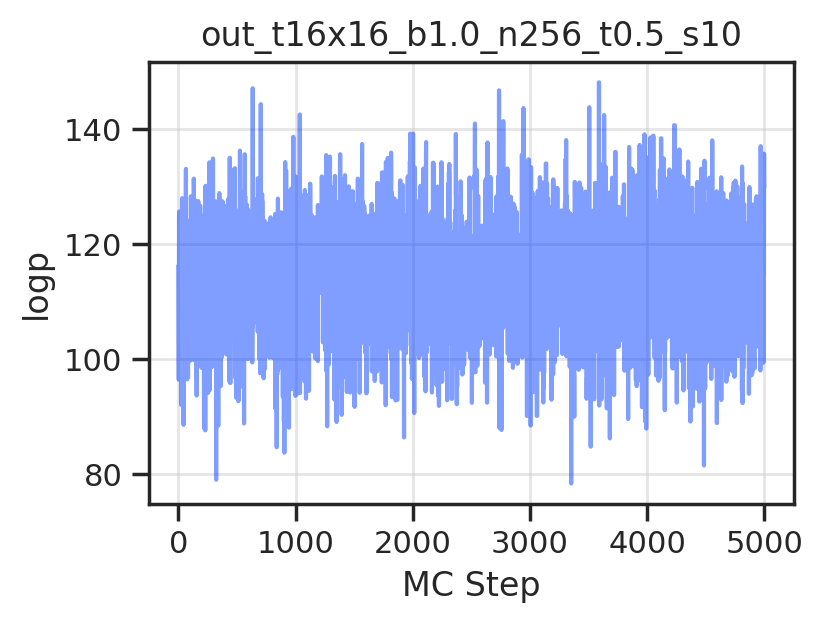

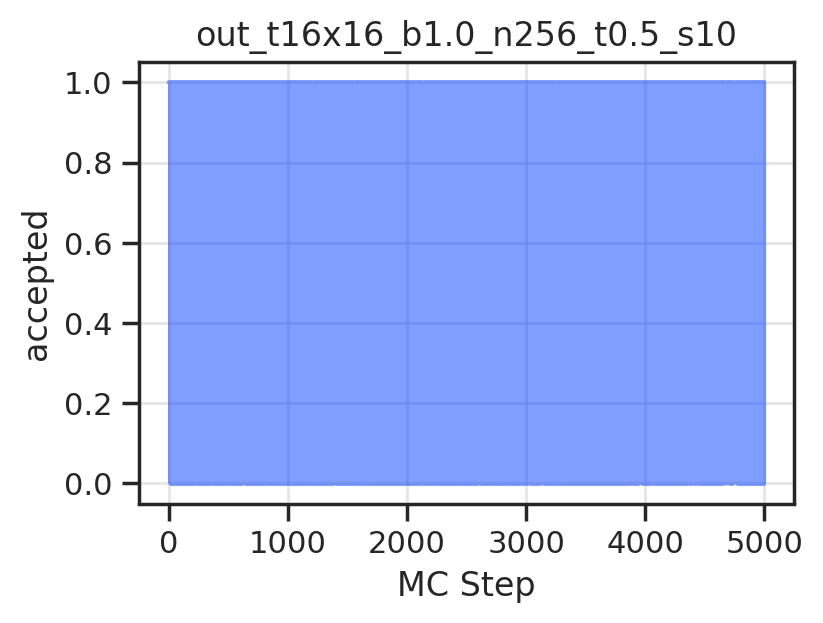

In [8]:
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed

history = make_mcmc_ensemble(model=train_outputs['model'],
                             action_fn=qed.BatchAction(param.beta),
                             batch_size=train_config.batch_size,
                             num_samples=5000)

outdir = os.path.join(PLOTS_DIR, 'inference', 'pre_flow_model', TSTAMP)
io.check_else_make_dir(outdir)

plot_history(history=history,
             param=param, skip=['epoch', 'x'],
             num_chains=2, therm_frac=0.0,#, thin=10,
             hline=True, xlabel='MC Step',
             outdir=outdir, alpha=0.5)

outdir = os.path.join(METRICS_DIR, 'inference', 'pre_flow_model', TSTAMP)
outfile = os.path.join(outdir, 'inference_metrics.z')

io.save_history(history, outfile, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

In [9]:
from fthmc.utils.samplers import generate_ensemble

outputs = generate_ensemble(pre_flow_model, flow_act, logger=logger)

u1_ens = outputs['ensemble']
pre_flow = pre_flow_model['layers']

[17:14:32]  accept_rate=0.666015625

            top_susceptibility=10.50677 +/- 0.85334

In [10]:
train_force = False
flow_model = None

if train_force:
    flow_model, flow_act = flow_train(param, with_force=True, pre_model=pre_flow_model)
else:
    flow_model = pre_flow_model
    
u1_ens = generate_ensemble(flow_model, flow_act, logger=logger)
flow = flow_model['layers']
# flow.eval()

[17:14:52]  accept_rate=0.6787109375

            top_susceptibility=9.98019 +/- 0.59307

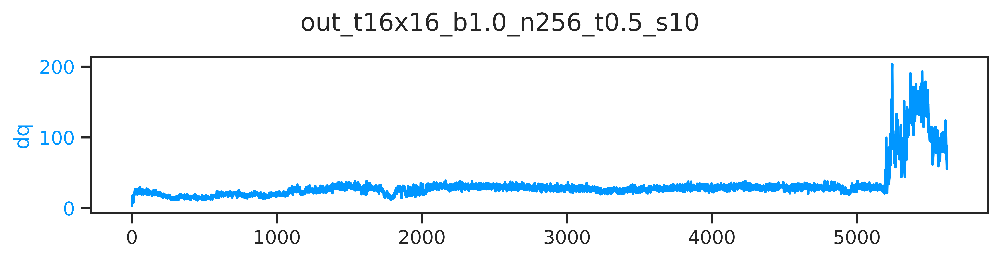

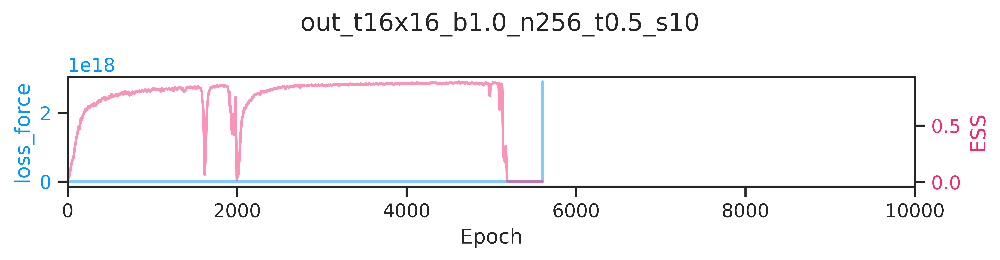

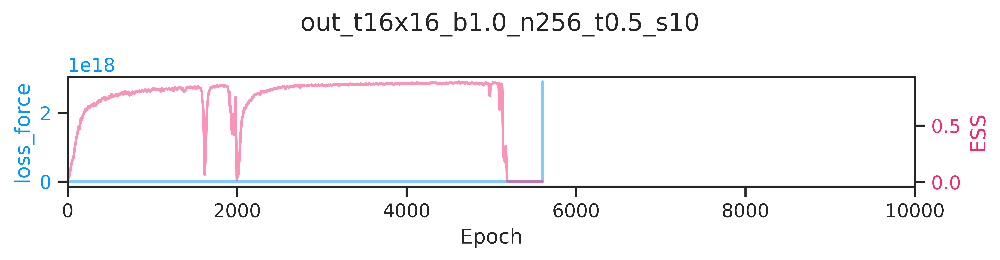

[17:17:31]  ---------------------------------------                                          
            ERA=0, last took: 0 min 0 s                                                      
            ---------------------------------------

[17:20:13]  epoch=97.000 step=0.000 dt=0.801 loss=58.5065 dq=22.7922 ess=0.272159            
            plaq=0.444561 loss_dkl=0   logp=113.808 logq=-888.075 loss_force=0.585           
            force_size=5850.65 force_norm=76.4844

[17:22:57]  epoch=197.000 step=0.000 dt=0.802 loss=30.6924 dq=20.0828 ess=0.616187           
            plaq=0.445296 loss_dkl=0   logp=113.996 logq=-887.618 loss_force=0.307           
            force_size=3069.24 force_norm=55.3969

[17:25:41]  epoch=297.000 step=0.000 dt=0.803 loss=24.7501 dq=13.057 ess=0.707209            
            plaq=0.443616 loss_dkl=0   logp=113.566 logq=-887.958 loss_force=0.248           
            force_size=2475.01 force_norm=49.7491

[17:28:26]  epoch=397.000 step=0.000 dt=0.804 loss=21.2507 dq=13.5719 ess=0.699252           
            plaq=0.444888 loss_dkl=0   logp=113.891 logq=-887.627 loss_force=0.213           
            force_size=2125.07 force_norm=46.0978

[17:31:11]  epoch=497.000 step=0.000 dt=0.804 loss=19.6688 dq=13.9133 ess=0.779131           
            plaq=0.443839 loss_dkl=0   logp=113.623 logq=-887.872 loss_force=0.197           
            force_size=1966.88 force_norm=44.3478

[17:33:56]  epoch=597.000 step=0.000 dt=0.805 loss=18.2678 dq=18.3687 ess=0.740045           
            plaq=0.445322 loss_dkl=0   logp=114.003 logq=-887.481 loss_force=0.183           
            force_size=1826.78 force_norm=42.7372

[17:36:41]  epoch=697.000 step=0.000 dt=0.805 loss=16.6316 dq=18.5352 ess=0.786863           
            plaq=0.445651 loss_dkl=0   logp=114.087 logq=-887.39 loss_force=0.166            
            force_size=1663.16 force_norm=40.7806

[17:39:26]  epoch=797.000 step=0.000 dt=0.804 loss=16.2425 dq=17.9102 ess=0.789726           
            plaq=0.442971 loss_dkl=0   logp=113.401 logq=-888.064 loss_force=0.162           
            force_size=1624.25 force_norm=40.2962

[17:42:11]  epoch=897.000 step=0.000 dt=0.805 loss=15.2963 dq=17.5477 ess=0.808998           
            plaq=0.445779 loss_dkl=0   logp=114.119 logq=-887.353 loss_force=0.153           
            force_size=1529.63 force_norm=39.106

[17:44:56]  epoch=997.000 step=0.000 dt=0.804 loss=14.7496 dq=18.7602 ess=0.806176           
            plaq=0.443855 loss_dkl=0   logp=113.627 logq=-887.808 loss_force=0.147           
            force_size=1474.96 force_norm=38.404

[17:44:59]  ---------------------------------------                                          
            ERA=1, last took: 27 min 27.52 s                                                 
            ---------------------------------------

[17:47:41]  epoch=97.000 step=97.000 dt=0.804 loss=14.4903 dq=26.3445 ess=0.801321           
            plaq=0.445166 loss_dkl=0   logp=113.962 logq=-887.48 loss_force=0.145            
            force_size=1449.03 force_norm=38.0654

[17:50:27]  epoch=197.000 step=197.000 dt=0.804 loss=13.9164 dq=24.6781 ess=0.823821         
            plaq=0.443422 loss_dkl=0   logp=113.516 logq=-887.943 loss_force=0.139           
            force_size=1391.64 force_norm=37.3046

[17:53:11]  epoch=297.000 step=297.000 dt=0.805 loss=13.4103 dq=24.6969 ess=0.825418         
            plaq=0.445787 loss_dkl=0   logp=114.121 logq=-887.335 loss_force=0.134           
            force_size=1341.03 force_norm=36.6197

[17:55:57]  epoch=397.000 step=397.000 dt=0.805 loss=13.6399 dq=30.282 ess=0.806032          
            plaq=0.444586 loss_dkl=0   logp=113.814 logq=-887.612 loss_force=0.136           
            force_size=1363.99 force_norm=36.9294

[17:58:43]  epoch=497.000 step=497.000 dt=0.806 loss=12.6641 dq=32.5898 ess=0.844544         
            plaq=0.443907 loss_dkl=0   logp=113.64 logq=-887.797 loss_force=0.127            
            force_size=1266.41 force_norm=35.5849

[18:01:28]  epoch=597.000 step=597.000 dt=0.806 loss=12.9185 dq=24.1641 ess=0.790715         
            plaq=0.44618 loss_dkl=0   logp=114.222 logq=-887.27 loss_force=0.129             
            force_size=1291.85 force_norm=35.9356

[18:04:13]  epoch=697.000 step=697.000 dt=0.806 loss=12.8171 dq=26.7727 ess=0.834758         
            plaq=0.446202 loss_dkl=0   logp=114.228 logq=-887.206 loss_force=0.128           
            force_size=1281.71 force_norm=35.8007

[18:06:59]  epoch=797.000 step=797.000 dt=0.807 loss=11.7037 dq=14.5641 ess=0.844253         
            plaq=0.443004 loss_dkl=0   logp=113.409 logq=-888.029 loss_force=0.117           
            force_size=1170.37 force_norm=34.2102

[18:09:44]  epoch=897.000 step=897.000 dt=0.806 loss=11.9096 dq=21.5633 ess=0.839239         
            plaq=0.446261 loss_dkl=0   logp=114.243 logq=-887.192 loss_force=0.119           
            force_size=1190.96 force_norm=34.5091

[18:12:30]  epoch=997.000 step=997.000 dt=0.842 loss=1596.48 dq=26.325 ess=0.160222          
            plaq=0.443955 loss_dkl=0   logp=113.652 logq=-908.158 loss_force=15.965          
            force_size=159648 force_norm=301.147

[18:12:33]  ---------------------------------------                                          
            ERA=2, last took: 27 min 34.18 s                                                 
            ---------------------------------------

[18:15:16]  epoch=97.000 step=194.000 dt=0.806 loss=26.9853 dq=31.3937 ess=0.65385           
            plaq=0.444747 loss_dkl=0   logp=113.855 logq=-887.689 loss_force=0.270           
            force_size=2698.53 force_norm=51.9434

[18:18:01]  epoch=197.000 step=394.000 dt=0.808 loss=19.2428 dq=31.7789 ess=0.744652         
            plaq=0.443715 loss_dkl=0   logp=113.591 logq=-887.878 loss_force=0.192           
            force_size=1924.28 force_norm=43.8662

[18:20:47]  epoch=297.000 step=594.000 dt=0.808 loss=15.9285 dq=28.0859 ess=0.808467         
            plaq=0.44345 loss_dkl=0   logp=113.523 logq=-887.93 loss_force=0.159             
            force_size=1592.85 force_norm=39.9099

[18:23:33]  epoch=397.000 step=794.000 dt=0.807 loss=14.6022 dq=32.1055 ess=0.810493         
            plaq=0.443795 loss_dkl=0   logp=113.611 logq=-887.852 loss_force=0.146           
            force_size=1460.22 force_norm=38.2118

[18:26:19]  epoch=497.000 step=994.000 dt=0.808 loss=13.5338 dq=31.1898 ess=0.832332         
            plaq=0.444515 loss_dkl=0   logp=113.796 logq=-887.641 loss_force=0.135           
            force_size=1353.38 force_norm=36.7877

[18:29:05]  epoch=597.000 step=1194.000 dt=0.808 loss=12.8019 dq=30.5023 ess=0.850559        
            plaq=0.445933 loss_dkl=0   logp=114.159 logq=-887.282 loss_force=0.128           
            force_size=1280.19 force_norm=35.7795

[18:31:51]  epoch=697.000 step=1394.000 dt=0.809 loss=12.4642 dq=30.0789 ess=0.861415        
            plaq=0.444914 loss_dkl=0   logp=113.898 logq=-887.53 loss_force=0.125            
            force_size=1246.42 force_norm=35.3038

[18:34:36]  epoch=797.000 step=1594.000 dt=0.808 loss=12.2757 dq=30.2625 ess=0.854889        
            plaq=0.442402 loss_dkl=0   logp=113.255 logq=-888.167 loss_force=0.123           
            force_size=1227.57 force_norm=35.0357

[18:37:23]  epoch=897.000 step=1794.000 dt=0.813 loss=11.924 dq=29.5109 ess=0.855755         
            plaq=0.446296 loss_dkl=0   logp=114.252 logq=-887.167 loss_force=0.119           
            force_size=1192.4 force_norm=34.5305

[18:40:10]  epoch=997.000 step=1994.000 dt=0.813 loss=11.6581 dq=27.1586 ess=0.857549        
            plaq=0.444578 loss_dkl=0   logp=113.812 logq=-887.611 loss_force=0.117           
            force_size=1165.81 force_norm=34.1431

[18:40:13]  ---------------------------------------                                          
            ERA=3, last took: 27 min 40.62 s                                                 
            ---------------------------------------

[18:42:58]  epoch=97.000 step=291.000 dt=0.814 loss=11.621 dq=26.2359 ess=0.855572           
            plaq=0.445887 loss_dkl=0   logp=114.147 logq=-887.294 loss_force=0.116           
            force_size=1162.1 force_norm=34.0884

[18:45:45]  epoch=197.000 step=591.000 dt=0.815 loss=11.2927 dq=26.5414 ess=0.865298         
            plaq=0.444304 loss_dkl=0   logp=113.742 logq=-887.695 loss_force=0.113           
            force_size=1129.27 force_norm=33.6042

[18:48:33]  epoch=297.000 step=891.000 dt=0.815 loss=11.3039 dq=24.5023 ess=0.866558         
            plaq=0.443518 loss_dkl=0   logp=113.541 logq=-887.884 loss_force=0.113           
            force_size=1130.39 force_norm=33.6205

[18:51:20]  epoch=397.000 step=1191.000 dt=0.814 loss=11.1044 dq=25.8906 ess=0.863498        
            plaq=0.444195 loss_dkl=0   logp=113.714 logq=-887.708 loss_force=0.111           
            force_size=1110.44 force_norm=33.3231

[18:54:07]  epoch=497.000 step=1491.000 dt=0.816 loss=10.901 dq=27.3734 ess=0.856445         
            plaq=0.443964 loss_dkl=0   logp=113.655 logq=-887.779 loss_force=0.109           
            force_size=1090.1 force_norm=33.0165

[18:56:55]  epoch=597.000 step=1791.000 dt=0.814 loss=10.8583 dq=27.5773 ess=0.867616        
            plaq=0.444359 loss_dkl=0   logp=113.756 logq=-887.687 loss_force=0.109           
            force_size=1085.83 force_norm=32.9503

[18:59:42]  epoch=697.000 step=2091.000 dt=0.815 loss=10.6497 dq=28.3102 ess=0.865024        
            plaq=0.445801 loss_dkl=0   logp=114.125 logq=-887.305 loss_force=0.106           
            force_size=1064.97 force_norm=32.6335

[19:02:33]  epoch=797.000 step=2391.000 dt=0.814 loss=10.6784 dq=28.8984 ess=0.872831        
            plaq=0.443629 loss_dkl=0   logp=113.569 logq=-887.857 loss_force=0.107           
            force_size=1067.84 force_norm=32.6775

[19:05:21]  epoch=897.000 step=2691.000 dt=0.814 loss=10.6379 dq=30.5484 ess=0.867883        
            plaq=0.445532 loss_dkl=0   logp=114.056 logq=-887.368 loss_force=0.106           
            force_size=1063.79 force_norm=32.6119

[19:08:08]  epoch=997.000 step=2991.000 dt=0.815 loss=10.3168 dq=28.2703 ess=0.872537        
            plaq=0.443534 loss_dkl=0   logp=113.545 logq=-887.879 loss_force=0.103           
            force_size=1031.68 force_norm=32.1188

[19:08:11]  ---------------------------------------                                          
            ERA=4, last took: 27 min 57.79 s                                                 
            ---------------------------------------

[19:10:56]  epoch=97.000 step=388.000 dt=0.817 loss=10.1976 dq=27.5586 ess=0.865054          
            plaq=0.444361 loss_dkl=0   logp=113.756 logq=-887.67 loss_force=0.102            
            force_size=1019.76 force_norm=31.9321

[19:13:43]  epoch=197.000 step=788.000 dt=0.816 loss=10.1303 dq=31.2391 ess=0.873147         
            plaq=0.443151 loss_dkl=0   logp=113.447 logq=-887.97 loss_force=0.101            
            force_size=1013.03 force_norm=31.8276

[19:16:31]  epoch=297.000 step=1188.000 dt=0.815 loss=10.1496 dq=30.5305 ess=0.869933        
            plaq=0.444111 loss_dkl=0   logp=113.692 logq=-887.737 loss_force=0.101           
            force_size=1014.96 force_norm=31.8583

[19:19:19]  epoch=397.000 step=1588.000 dt=0.816 loss=10.1733 dq=31.0891 ess=0.868266        
            plaq=0.445175 loss_dkl=0   logp=113.965 logq=-887.456 loss_force=0.102           
            force_size=1017.33 force_norm=31.8942

[19:22:06]  epoch=497.000 step=1988.000 dt=0.816 loss=9.94099 dq=26.9156 ess=0.87488         
            plaq=0.444823 loss_dkl=0   logp=113.875 logq=-887.579 loss_force=0.099           
            force_size=994.099 force_norm=31.5284

[19:24:54]  epoch=597.000 step=2388.000 dt=0.815 loss=9.87037 dq=28.4883 ess=0.88343         
            plaq=0.443657 loss_dkl=0   logp=113.576 logq=-887.841 loss_force=0.099           
            force_size=987.037 force_norm=31.4148

[19:27:41]  epoch=697.000 step=2788.000 dt=0.817 loss=9.77477 dq=28.8258 ess=0.863866        
            plaq=0.444554 loss_dkl=0   logp=113.806 logq=-887.613 loss_force=0.098           
            force_size=977.477 force_norm=31.2634

[19:30:29]  epoch=797.000 step=3188.000 dt=0.820 loss=9.72639 dq=30.8109 ess=0.873531        
            plaq=0.445318 loss_dkl=0   logp=114.001 logq=-887.433 loss_force=0.097           
            force_size=972.639 force_norm=31.1854

[19:33:17]  epoch=897.000 step=3588.000 dt=0.816 loss=10.0248 dq=25.6297 ess=0.868143        
            plaq=0.446283 loss_dkl=0   logp=114.248 logq=-887.178 loss_force=0.100           
            force_size=1002.48 force_norm=31.6579

[19:36:04]  epoch=997.000 step=3988.000 dt=0.815 loss=10.7591 dq=25.8297 ess=0.821372        
            plaq=0.445286 loss_dkl=0   logp=113.993 logq=-887.469 loss_force=0.108           
            force_size=1075.91 force_norm=32.7987

[19:36:07]  ---------------------------------------                                          
            ERA=5, last took: 27 min 55.87 s                                                 
            ---------------------------------------

[19:38:52]  epoch=97.000 step=485.000 dt=0.816 loss=9.95379 dq=30.1125 ess=0.871849          
            plaq=0.44515 loss_dkl=0   logp=113.958 logq=-887.468 loss_force=0.100            
            force_size=995.379 force_norm=31.5488

[19:41:43]  epoch=197.000 step=985.000 dt=0.977 loss=1.85737e+07 dq=34.6414 ess=0.00568031   
            plaq=0.446295 loss_dkl=0   logp=114.252 logq=-1126.18 loss_force=185737.105      
            force_size=1.85737e+09 force_norm=34460.8

[19:47:36]  epoch=297.000 step=1485.000 dt=1.836 loss=6.50437e+16 dq=79.5859 ess=0.00437539  
            plaq=0.258283 loss_dkl=0   logp=66.1204 logq=-1638.88                            
            loss_force=650437488053059.625 force_size=6.50437e+18 force_norm=2.5203e+09

[19:53:52]  epoch=397.000 step=1985.000 dt=1.771 loss=5.32117e+16 dq=138.302 ess=0.00405844  
            plaq=0.272131 loss_dkl=0   logp=69.6656 logq=-1663.78                            
            loss_force=532117083282997.312 force_size=5.32117e+18 force_norm=2.26325e+09

[19:59:55]  epoch=497.000 step=2485.000 dt=1.691 loss=4.29039e+16 dq=113.691 ess=0.00501489  
            plaq=0.303208 loss_dkl=0   logp=77.6212 logq=-1598.14                            
            loss_force=429038774417096.750 force_size=4.29039e+18 force_norm=2.01177e+09

[20:05:40]  epoch=597.000 step=2985.000 dt=1.668 loss=3.61379e+16 dq=93.957 ess=0.0039456    
            plaq=0.296519 loss_dkl=0   logp=75.9089 logq=-1577.05                            
            loss_force=361378874702954.500 force_size=3.61379e+18 force_norm=1.88818e+09

[20:12:49]  epoch=697.000 step=3485.000 dt=2.230 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[20:20:21]  epoch=797.000 step=3985.000 dt=2.235 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[20:27:52]  epoch=897.000 step=4485.000 dt=2.234 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[20:35:24]  epoch=997.000 step=4985.000 dt=2.311 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[20:35:26]  ---------------------------------------                                          
            ERA=6, last took: 59 min 19.44 s                                                 
            ---------------------------------------

[20:42:54]  epoch=97.000 step=582.000 dt=2.229 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0   
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[20:50:24]  epoch=197.000 step=1182.000 dt=2.228 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[20:57:54]  epoch=297.000 step=1782.000 dt=2.239 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[21:05:24]  epoch=397.000 step=2382.000 dt=2.233 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[21:12:55]  epoch=497.000 step=2982.000 dt=2.228 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[21:20:28]  epoch=597.000 step=3582.000 dt=2.230 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[21:27:59]  epoch=697.000 step=4182.000 dt=2.232 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[21:35:29]  epoch=797.000 step=4782.000 dt=2.232 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[21:43:02]  epoch=897.000 step=5382.000 dt=2.233 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[21:50:33]  epoch=997.000 step=5982.000 dt=2.230 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[21:50:36]  ---------------------------------------                                          
            ERA=7, last took: 75 min 9.264 s                                                 
            ---------------------------------------

[21:58:04]  epoch=97.000 step=679.000 dt=2.234 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0   
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[22:05:35]  epoch=197.000 step=1379.000 dt=2.229 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[22:13:06]  epoch=297.000 step=2079.000 dt=2.230 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[22:20:38]  epoch=397.000 step=2779.000 dt=2.256 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[22:28:11]  epoch=497.000 step=3479.000 dt=2.240 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[22:35:43]  epoch=597.000 step=4179.000 dt=2.234 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[22:43:13]  epoch=697.000 step=4879.000 dt=2.232 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[22:50:45]  epoch=797.000 step=5579.000 dt=2.230 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[22:58:16]  epoch=897.000 step=6279.000 dt=2.234 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[23:05:46]  epoch=997.000 step=6979.000 dt=2.228 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[23:05:49]  ---------------------------------------                                          
            ERA=8, last took: 75 min 13.25 s                                                 
            ---------------------------------------

[23:13:17]  epoch=97.000 step=776.000 dt=2.227 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0   
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[23:20:47]  epoch=197.000 step=1576.000 dt=2.228 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[23:28:20]  epoch=297.000 step=2376.000 dt=2.237 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[23:35:51]  epoch=397.000 step=3176.000 dt=2.235 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[23:43:23]  epoch=497.000 step=3976.000 dt=2.236 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[23:50:54]  epoch=597.000 step=4776.000 dt=2.207 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[23:58:21]  epoch=697.000 step=5576.000 dt=2.208 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[00:05:48]  epoch=797.000 step=6376.000 dt=2.208 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[00:13:15]  epoch=897.000 step=7176.000 dt=2.212 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[00:20:42]  epoch=997.000 step=7976.000 dt=2.212 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[00:20:45]  ---------------------------------------                                          
            ERA=9, last took: 74 min 55.99 s                                                 
            ---------------------------------------

[00:28:10]  epoch=97.000 step=873.000 dt=2.215 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0   
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[00:35:39]  epoch=197.000 step=1773.000 dt=2.211 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[00:43:07]  epoch=297.000 step=2673.000 dt=2.225 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[00:50:35]  epoch=397.000 step=3573.000 dt=2.219 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[00:58:04]  epoch=497.000 step=4473.000 dt=2.217 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[01:05:34]  epoch=597.000 step=5373.000 dt=2.235 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[01:13:03]  epoch=697.000 step=6273.000 dt=2.217 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[01:20:30]  epoch=797.000 step=7173.000 dt=2.213 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[01:27:58]  epoch=897.000 step=8073.000 dt=2.220 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

[01:35:27]  epoch=997.000 step=8973.000 dt=2.222 loss=nan dq=nan ess=nan plaq=nan loss_dkl=0 
            logp=nan logq=nan loss_force=nan  force_size=nan force_norm=nan

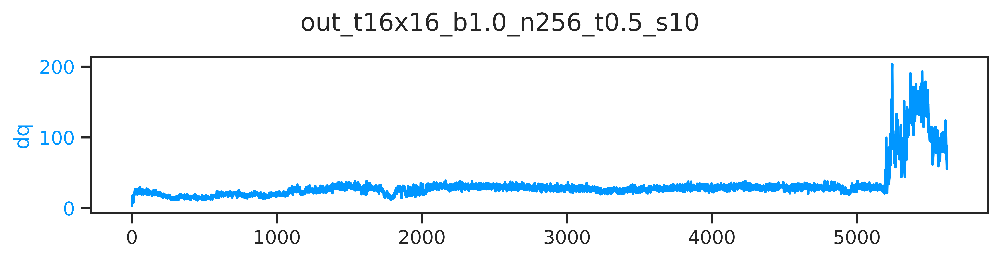

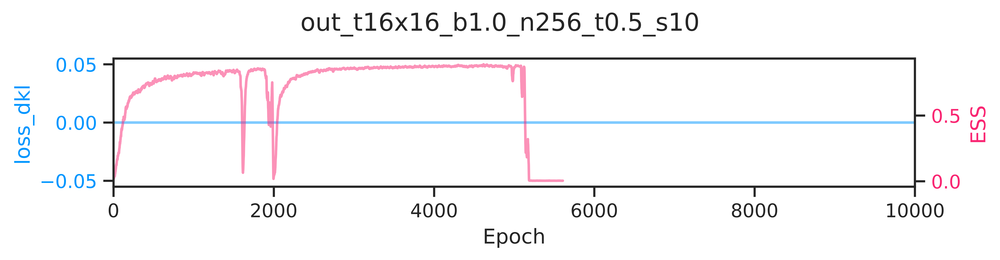

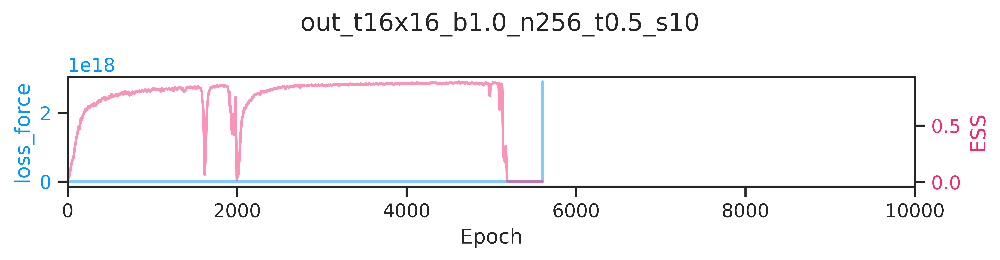

In [12]:
import seaborn as sns

from dataclasses import asdict
from copy import deepcopy
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_u1_equiv_layers, set_weights
from math import pi as PI
import fthmc.utils.qed_helpers as qed

TWO_PI = 2 * PI
# from train import train

sns.set_context('notebook')
sns.set_palette('bright')

train_cfg_force = asdict(train_config)
train_cfg_force['with_force'] = True

tconfig_force = TrainConfig(**train_cfg_force)

link_shape = (2, *param.lat)
lattice_shape = tuple(param.lat)
u1_action = qed.BatchAction(param.beta)

prior_force = MultivariateUniform(torch.zeros(link_shape),
                            TWO_PI * torch.ones(link_shape))

layers_force = make_u1_equiv_layers(lattice_shape=lattice_shape,
                                    n_layers=tconfig_force.n_layers,
                                    n_mixture_comps=tconfig_force.n_s_nets,
                                    hidden_sizes=tconfig_force.hidden_sizes,
                                    kernel_size=tconfig_force.kernel_size)

set_weights(layers_force)

model_force = {
    'prior': prior_force,
    'layers': layers_force,
}
                              

outputs_force = train(param, tconfig_force,
                      model=model_force,
                      pre_model=pre_flow_model,
                      figsize=(8, 2.))
                      #force_factor=1.,
                      #dkl_factor=1.)#, logger=logger)

flow_model_force = outputs_force['model']
flow_model_force_history = outputs_force['history']
flow_action_force = outputs_force['action']

In [ ]:
def test_force(
    param: Param,
    model: dict,
    x: torch.Tensor = None,
    pre_model: dict = None
):
    """Test the force.
    
    If `x` is None:
      - Draw samples `xi (~ pre_prior)` from prior and pass through `pre_model` to get `x (~ pre_posterior)`.
     
    Pass `x` backwards through the `model` to get `xi (~ prior)`.
    
    Calculate `force(xi)` and `norm(force(xi))`.
    """
    if x is None:
        if pre_model is None:
            raise ValueError(f'Either `x` or `pre_model` must be specified.')
            
        # Draw samples `xi` from prior
        pre_xi = pre_model['prior'].sample_n(1)
        
        # Pass `xi` through layers in `pre_model`
        x = qed.ft_flow(pre_model['layers'], pre_xi)
        
    # Pass `x` backwards through layers in `model`
    xi = qed.ft_flow_inv(model['layers'], x)
    # Calculate force
    force = qed.ft_force(param, model['layers'], xi)
    force_norm = torch.linalg.norm(force)
    return force_norm

In [ ]:
from train import run as hmc_run
fields, metrics = hmc_run(param, logger=logger, keep_fields=True)

#metrics_dir = os.path.join(OUTDIR, 'metrics', 'hmc')
#metrics_file = os.path.join(metrics_dir, 'metrics.z')
#io.savez(metrics, metrics_file)

In [ ]:
#field_arr = torch.stack(tuple(fields.values()), dim=0)
len(fields)
#
field_arr = np.array([qed.grab(torch.stack(i)) for i in fields])
field_arr.shape
#logger.log(field_arr.shape)

In [ ]:
for field in field_arr:
    force_tf = test_force(param, flow_model_force, pre_model=pre_flow_model)
    logger.log(f'ft_flow(players, pxi), (pxi ~ pre_prior): {force_tf:.5g}') 
    
    x = torch.from_numpy(field[-1]).squeeze()[None, :]
    if torch.cuda.is_available():
        x = x.cuda()
    
    #x_ = field_arr.squeeze()[None, :]
    force_ = test_force(param, flow_model_force, x=x, pre_model=pre_flow_model)
    logger.log(f'ft_flow(layers, field_arr), (pxi ~ pre_prior): {force_:.5g}')

In [ ]:
# field_arr generated from generic HMC run
for idx, fields in enumerate(field_arr):
    # x generated from HMC
    x = torch.from_numpy(fields)
    if torch.cuda.is_available():
        x = x.cuda()
        
    # flow HMC samples backwards through `flow_model_force` and calculate force
    force1 = test_force(param, flow_model_force, x=x)
    
    # sample x ~ pre_flow_model_prior, flow through `pre_flow_model` to get xi 
    # flow xi backwards through `flow_model_force` and calculate force
    force2 = test_force(param, flow_model_force, pre_model=pre_flow_model)
    
    logger.log(f'run={idx}\n'
               f'  (xi ~ HMC): force_xi={force1:.5g}\n'
               f"  (xi ~ pre_flow_model_prior): force_xi_pre={force2:.5g}")

In [ ]:
#field_run = torch.stack(tuple(fields.values()), dim=0)
##flows = flow

#x0 = field_arr[0][None, :]
#x = field_arr[0][None, :]

# select last trajectory from last run
x = torch.from_numpy(field_arr[-1][-1][None, :]).cuda()
x0 = torch.from_numpy(field_arr[-1][-1][None, :]).cuda()

if torch.cuda.is_available():
    x = x.cuda()

plaq0 = qed.action(param, x) / (-param.beta * param.volume)
logger.log(f'plaq(field_arr[0])={plaq0:.8g}')

#logger\.log(f'plaq(field_run[0]) {qed.action(param, x) / (-param.beta*param.volume)}')
# field.requires_grad_(True)
#x = field_run[0][None, :]
logJ = 0.0
for layer in reversed(flow_model_force['layers']):
    x, lJ = layer.reverse(x)
    logJ += lJ

# x is the prior distribution now
    
x.requires_grad_(True)
    
y = x
logJy = 0.0
for layer in flow_model_force['layers']:
    y, lJ = layer.forward(y)
    logJy += lJ
    
s = qed.action(param, y[0][None, :]) - logJy

logger.log(f'sum(logJ): {qed.grab(logJ.sum())}')
logger.log(f'sum(logJy): {qed.grab(logJy.sum())}')
#print(logJ,logJy)


# print("eff_action", s + 136.3786)

logger.log(f'original_action: {qed.action(param, y[0][None, :]) + 91}')
#print("original_action", qed.action(param, y[0][None, :]) + 91)

logger.log(f'eff_action: {s + 56}')
#print("eff_action", {s + 56)

s.backward()

f = x.grad

x.requires_grad_(False)

logger.log(f'plaq(x) {qed.action(param, x[0][None, :]) / (-param.beta*param.volume)}  logJ {qed.grab(logJ)}  force.norm {torch.linalg.norm(f)}')
logger.log(f'plaq(y) {qed.action(param, y[0][None, :]) / (-param.beta*param.volume)}')
logger.log(f'plaq(x) {qed.action(param, x0) / (-param.beta*param.volume)}  force.norm {torch.linalg.norm(qed.force(param, x0))}')

In [ ]:
logger.log(x.shape)

field_tensor = torch.from_numpy(field_arr).cuda()

x = qed.ft_flow_inv(flow, field_tensor[-1])
# x = field_run
#for layer in reversed(flows):
#    x, lJ = layer.reverse(x)
ff = qed.ft_force(param, flow, x)
logger.log(torch.linalg.norm(ff))
fff = qed.ft_force(param, flow, x)
logger.log(torch.linalg.norm(fff))

In [ ]:
x = qed.ft_flow_inv(flow, field_tensor[-1])
logger.log(qed.grab(qed.ft_action(param, flow, x)))